# Small DC panel analysis of ConvexGating results

We use the `convexgating` tool to compute gates for a simple flow data set with the small DC panel. Here, we plot the resulting F1, precision and recall scores per cell type and transfer gating results to the other samples.

## Load packages

In [1]:
%load_ext autoreload
%autoreload 2

In [26]:
import os
import scanpy as sc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

Import gate transfer function.

In [3]:
from rev03_apply_strategy_to_new_anndata import apply_gating_strategy

In [4]:
import convexgating as cg 
from convex_hull_add_on import add_tight_analysis

In [51]:
from contour_scatter import contour_lines_separate_outliers, generate_lut_func, prepare_contour_plot

Show versions.

In [6]:
sc.logging.print_versions()

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.8.0
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                                 8.4.0
anyio                               NA
asciitree                           NA
attr                                21.2.0
autoreload                          NA
babel                               2.9.1
backcall                            0.2.0
beta_ufunc                          NA
binom_ufunc                         NA
brotli                              1.0.9
certifi                             2021.10

Custom color for performance plots throughout the paper.

In [6]:
colors = {
"f1": "#663171",
"recall": "#e2998a",
"precision": "#0c7156",
}

## Plot performance scores 

### Cell type level 1

Set paths to files.

In [4]:
project_dir = '../data/performance_test/convex_gating/Hofer_data/cell_types'

In [5]:
dirs = os.listdir(project_dir)

In [6]:
dict_performance = dict()
for directory in dirs:
    subdir = os.listdir(os.path.join(project_dir, directory))
    subdir_name = [idx for idx in subdir if idx.startswith('cluster_')]
    if len(subdir_name)==0:
        continue
    key = subdir_name[0].split('cluster_')[1]
    sample = directory.split('_')[-1]
    if key =='not annotated':
        continue
    
    tmp = pd.read_csv(f'{project_dir}/{directory}/{subdir_name[0]}/performance.csv', index_col=0)
    tmp['score'] = tmp.index.values
    tmp['cell_type'] = key
    tmp['sample'] = sample
    dict_performance[directory] = tmp

In [7]:
tmp

,hierarchy_1,hierarchy_2,hierarchy_3,hierarchy_4,hierarchy_5,score,cell_type,sample
f1,0.968501,0.970243,0.963146,0.954562,0.945683,f1,monocyte,MF
recall,0.951281,0.949461,0.929301,0.913202,0.896962,recall,monocyte,MF
precision,0.986355,0.991956,0.999548,0.999847,1.000000,precision,monocyte,MF


In [9]:
scores = pd.concat(dict_performance, ignore_index=True)

Check NAs and fill in from previous hierarchies.

In [11]:
cols = ['hierarchy_2', 'hierarchy_3', 'hierarchy_4', 'hierarchy_5']
for idx, column in enumerate(cols):
    na_row =scores[column].isna()
    scores[column][na_row] = scores[cols[idx-1]][na_row] 

/tmp/ipykernel_4021362/4041294965.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores[column][na_row] = scores[cols[idx-1]][na_row]


Save to file.

In [12]:
scores.to_csv(os.path.join("../data/performance_test/convex_gating/Hofer_data", 
                           "performance_summary_Hofer_level1.csv"))

Plot performance in hierarchy 5.

/tmp/ipykernel_4021362/2173084631.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


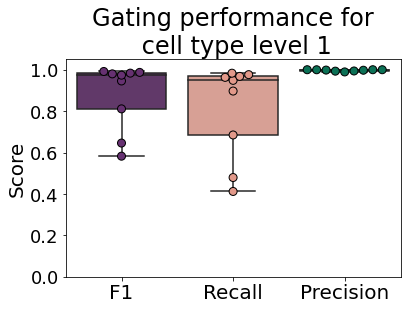

In [13]:
fig, ax = plt.subplots()

sns.boxplot(data = scores, y='hierarchy_5', x='score', palette=colors)
sns.swarmplot(data = scores, y='hierarchy_5', x='score',edgecolor='k', 
              linewidth=1, size=8, palette=colors)
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Gating performance for\n cell type level 1', fontsize=24)
plt.savefig('../figures/performance_cell_types_lvl1_Hofer.png', bbox_inches='tight')
plt.savefig('../figures/performance_cell_types_lvl1_Hofer.pdf', bbox_inches='tight')
plt.show()

### Cell type level 2

Set paths to files.

In [63]:
project_dir = '../data/performance_test/convex_gating/Hofer_data/cell_types_lvl2'

In [64]:
dirs = os.listdir(project_dir)

In [65]:
dict_performance = dict()
for directory in dirs:
    subdir = os.listdir(os.path.join(project_dir, directory))
    subdir_name = [idx for idx in subdir if idx.startswith('cluster_')]
    if len(subdir_name)==0:
        continue
    key = subdir_name[0].split('cluster_')[1]
    sample = directory.split('_')[-1]
    if key =='not annotated':
        continue
    
    tmp = pd.read_csv(f'{project_dir}/{directory}/{subdir_name[0]}/performance.csv', index_col=0)
    tmp['score'] = tmp.index.values
    tmp['cell_type'] = key
    tmp['sample'] = sample
    dict_performance[directory] = tmp

In [66]:
scores = pd.concat(dict_performance, ignore_index=True)

In [67]:
scores = scores[scores['cell_type']!='monocyte']

In [70]:
scores.loc[scores['cell_type']=='non-classical monocyte']

,hierarchy_1,hierarchy_2,hierarchy_3,hierarchy_4,hierarchy_5,score,cell_type,sample
18,0.826979,0.834575,0.876623,0.879085,0.877250,f1,non-classical monocyte,KR
19,0.867692,0.861538,0.830769,0.827692,0.824615,recall,non-classical monocyte,KR
20,0.789916,0.809249,0.927835,0.937282,0.937063,precision,non-classical monocyte,KR
21,0.852227,0.888412,0.892039,0.894737,0.897464,f1,non-classical monocyte,KW
22,0.860941,0.846626,0.836401,0.834356,0.832311,recall,non-classical monocyte,KW
23,0.843687,0.934537,0.955607,0.964539,0.973684,precision,non-classical monocyte,KW
24,0.837624,0.865424,0.873662,0.873662,0.874598,f1,non-classical monocyte,MF
25,0.815029,0.805395,0.786127,0.786127,0.786127,recall,non-classical monocyte,MF
26,0.861507,0.935123,0.983133,0.983133,0.985507,precision,non-classical monocyte,MF


Check NAs and fill in from previous hierarchies.

In [71]:
cols = ['hierarchy_2', 'hierarchy_3', 'hierarchy_4', 'hierarchy_5']
for idx, column in enumerate(cols):
    na_row =scores[column].isna()
    scores[column][na_row] = scores[cols[idx-1]][na_row] 

Save to file.

In [25]:
scores.to_csv(os.path.join("../data/performance_test/convex_gating/Hofer_data", 
                           "performance_summary_Hofer_level2.csv"))

Plot performance in hierarchy 5.

/tmp/ipykernel_4021362/1766691955.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


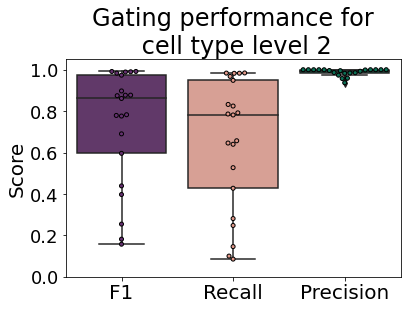

In [26]:
fig, ax = plt.subplots()

sns.boxplot(data = scores, y='hierarchy_5', x='score', palette=colors)
sns.swarmplot(data = scores, y='hierarchy_5', x='score',edgecolor='k', 
              linewidth=1, size=4, palette=colors)
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Gating performance for\n cell type level 2', fontsize=24)
plt.savefig('../figures/performance_cell_types_lvl2_Hofer.png', bbox_inches='tight')
plt.savefig('../figures/performance_cell_types_lvl2_Hofer.pdf', bbox_inches='tight')
plt.show()

## Transfer gates to the other samples

As part of the revision, we implemented a function to apply the gating strategy to other samples. This function does not create a visualization, it classifies cells for being "in" or "out" of any inferred gating strategy and computes the performance scores. 

We demonstrate the applicability of the gate transfer in the case of the subsets of DCs, which we annotated in this dataset.

Load anndata object with all cells. 

In [7]:
adata = sc.read('./../data/Hofer_IMA/mono_merge_annotated.h5ad')

In [8]:
pd.crosstab(adata.obs['cell_types_lvl2'], adata.obs['sample'], normalize=1)

sample,KR,KW,MF
cell_types_lvl2,,,
B cell,0.062884,0.099464,0.128787
classical monocyte,0.149641,0.192683,0.128954
non-classical monocyte,0.006008,0.009357,0.010444
intermediate monocyte,0.005666,0.004448,0.004417
"DC Q1(CD14-, CD5+)",0.001363,0.000793,0.002466
"DC Q3(CD14+, CD5-)",0.002305,0.002588,0.003176
"DC Q4(CD14-, CD5-)",0.001698,0.000763,0.002153
not annotated,0.770435,0.689904,0.719603


### Main types

Set paths to files.

In [10]:
project_dir = '../data/performance_test/convex_gating/Hofer_data/cell_types'

In [11]:
dirs = os.listdir(project_dir)

For the main types that are annotated in cell type level 1, we transfer the gates across samples. 

In [12]:
dirs_dc = [dirID for dirID in dirs if dirID.startswith('cluster_')]

In [14]:
cluster_string = 'cell_types'
clusters = ['B cell', 'dendritic cell',  'monocyte']
samples = ['KR', 'KW', 'MF']
sample_dict = {'KR': ['KW', 'MF'], 
               'KW': ['KR', 'MF'], 
               'MF': ['KR', 'KW']
              }
result_dict = {}

for cluster in clusters:
    result_dict_cluster = {}
    for sample in samples:
        result_dict_cluster_sample = {}
        #get ConvexGating output files
        base_dir = 'cluster_{}_batch_{}/'.format(cluster, sample)
        base_path = os.path.join(project_dir, base_dir)
        for target_sample in sample_dict[sample]:
            #subset adata to one of the target samples 
            adata_sample = adata[adata.obs['sample']==target_sample].copy()
            f1, recall, precision = apply_gating_strategy(adata = adata_sample,
                      base_path = base_path,
                      cluster = cluster,
                      cluster_string = cluster_string,
                      output_scores =True)
            result_dict_cluster_sample[target_sample] = {'f1' : f1, 
                                                         'recall' : recall, 
                                                         'precision': precision}
        #turn dictionary into dataframe
        result_df_sample = pd.DataFrame(result_dict_cluster_sample).T.reset_index().rename(columns={'index' : 'target_sample'})
        result_dict_cluster[sample] = result_df_sample
    result_dict[cluster] = result_dict_cluster
            

In [15]:
res_ct = {}
for cluster in clusters:
    res_ct[cluster] = pd.concat(result_dict[cluster]).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'source_sample'})


In [16]:
transfer_scores = pd.concat(res_ct).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'cell_type'})

In [17]:
transfer_scores = transfer_scores.melt(['cell_type', 'source_sample','target_sample'])

/tmp/ipykernel_751997/3353309275.py:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


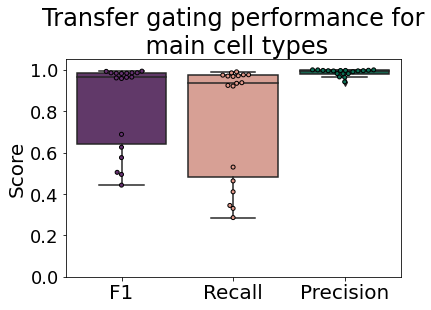

In [19]:
fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores, 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores, y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n main cell types', fontsize=24)
plt.savefig('../figures/performance_transfer_cell_types_lvl1_Hofer.png', bbox_inches='tight')
plt.savefig('../figures/performance_transfer_cell_types_lvl1_Hofer.pdf', bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/2014859817.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


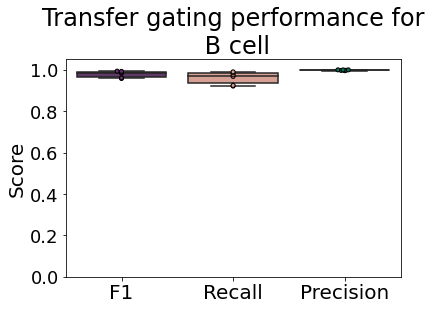

In [20]:
cell_type = 'B cell'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/2695138096.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


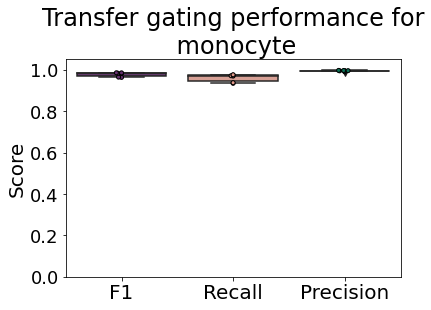

In [21]:
cell_type = 'monocyte'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/748256338.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


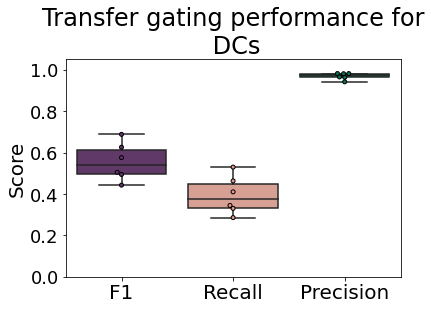

In [22]:
cell_type = 'dendritic cell'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n DCs', fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

### DC subsets

Set paths to files.

In [5]:
project_dir = '../data/performance_test/convex_gating/Hofer_data/cell_types_lvl2'

In [6]:
dirs = os.listdir(project_dir)

For the subsets of DCs that are annotated in cell type level 2, we transfer the gates across samples. 

In [12]:
dirs_dc = [dirID for dirID in dirs if dirID.startswith('cluster_DC Q')]

In [40]:
cluster_string = 'cell_types_lvl2'
clusters = ['DC Q1(CD14-, CD5+)', 'DC Q3(CD14+, CD5-)',  'DC Q4(CD14-, CD5-)']
samples = ['KR', 'KW', 'MF']
sample_dict = {'KR': ['KW', 'MF'], 
               'KW': ['KR', 'MF'], 
               'MF': ['KR', 'KW']
              }
result_dict = {}

for cluster in clusters:
    result_dict_cluster = {}
    for sample in samples:
        result_dict_cluster_sample = {}
        #get ConvexGating output files
        base_dir = 'cluster_{}_batch_{}/'.format(cluster, sample)
        base_path = os.path.join(project_dir, base_dir)
        for target_sample in sample_dict[sample]:
            #subset adata to one of the target samples 
            adata_sample = adata[adata.obs['sample']==target_sample].copy()
            f1, recall, precision = apply_gating_strategy(adata = adata_sample,
                      base_path = base_path,
                      cluster = cluster,
                      cluster_string = cluster_string,
                      output_scores =True)
            result_dict_cluster_sample[target_sample] = {'f1' : f1, 
                                                         'recall' : recall, 
                                                         'precision': precision}
        #turn dictionary into dataframe
        result_df_sample = pd.DataFrame(result_dict_cluster_sample).T.reset_index().rename(columns={'index' : 'target_sample'})
        result_dict_cluster[sample] = result_df_sample
    result_dict[cluster] = result_dict_cluster
            

In [87]:
res_ct = {}
res_ct['DC Q1(CD14-, CD5+)'] = pd.concat(result_dict['DC Q1(CD14-, CD5+)']).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'source_sample'})
res_ct['DC Q3(CD14+, CD5-)'] = pd.concat(result_dict['DC Q3(CD14+, CD5-)']).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'source_sample'})
res_ct['DC Q4(CD14-, CD5-)'] = pd.concat(result_dict['DC Q4(CD14-, CD5-)']).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'source_sample'})

In [88]:
transfer_scores = pd.concat(res_ct).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'cell_type'})

In [89]:
transfer_scores = transfer_scores.melt(['cell_type', 'source_sample','target_sample'])

/tmp/ipykernel_705330/2239290732.py:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


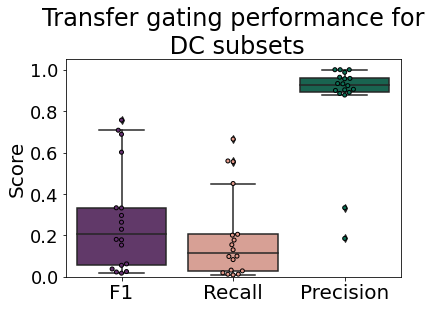

In [95]:
fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores, 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores, y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n DC subsets', fontsize=24)
plt.savefig('../figures/performance_transfer_allDC_Hofer.png', bbox_inches='tight')
plt.savefig('../figures/performance_transfer_allDC_Hofer.pdf', bbox_inches='tight')
plt.show()

/tmp/ipykernel_705330/4040452172.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


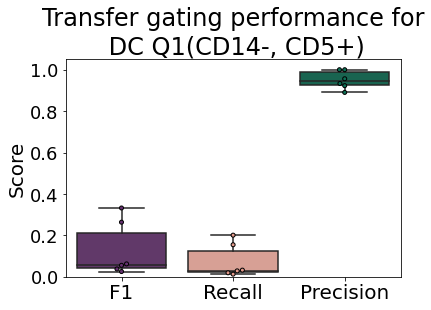

In [96]:
cell_type = 'DC Q1(CD14-, CD5+)'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_705330/1166578922.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


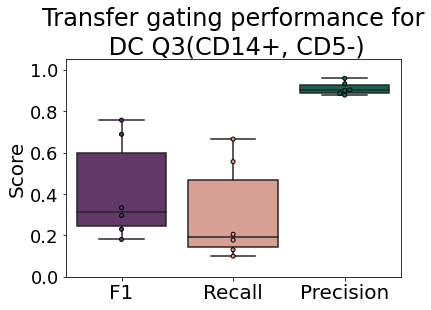

In [98]:
cell_type = 'DC Q3(CD14+, CD5-)'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_705330/1312607641.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


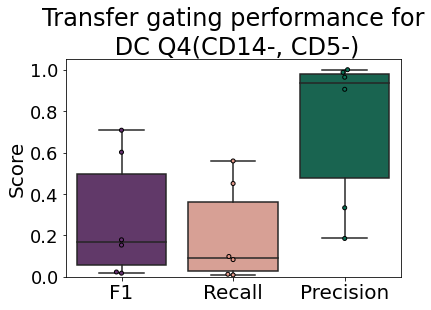

In [99]:
cell_type = 'DC Q4(CD14-, CD5-)'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

In [73]:
scores.loc[scores['cell_type'].isin(clusters)].sort_values(['cell_type', 'score'])

,hierarchy_1,hierarchy_2,hierarchy_3,hierarchy_4,hierarchy_5,score,cell_type,sample
45,0.426540,0.745763,0.724138,0.701754,0.690265,f1,"DC Q1(CD14-, CD5+)",KR
48,0.133333,0.285714,0.254545,0.254545,0.254545,f1,"DC Q1(CD14-, CD5+)",KW
69,0.083333,0.186047,0.186047,0.171875,0.157480,f1,"DC Q1(CD14-, CD5+)",MF
47,0.328467,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",KR
50,0.103448,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",KW
71,0.066667,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",MF
46,0.608108,0.594595,0.567568,0.540541,0.527027,recall,"DC Q1(CD14-, CD5+)",KR
49,0.187500,0.166667,0.145833,0.145833,0.145833,recall,"DC Q1(CD14-, CD5+)",KW
70,0.111111,0.102564,0.102564,0.094017,0.085470,recall,"DC Q1(CD14-, CD5+)",MF
51,0.194529,0.418301,0.418301,0.407895,0.397351,f1,"DC Q3(CD14+, CD5-)",KR


### Monocyte subsets

Set paths to files.

In [24]:
project_dir = '../data/performance_test/convex_gating/Hofer_data/cell_types_lvl2'

In [25]:
dirs = os.listdir(project_dir)

For the subsets of DCs that are annotated in cell type level 2, we transfer the gates across samples. 

In [26]:
dirs_dc = [dirID for dirID in dirs if dirID.count(' monocyte')>0]

In [28]:
cluster_string = 'cell_types_lvl2'
clusters = ['classical monocyte', 'non-classical monocyte',  'intermediate monocyte']
samples = ['KR', 'KW', 'MF']
sample_dict = {'KR': ['KW', 'MF'], 
               'KW': ['KR', 'MF'], 
               'MF': ['KR', 'KW']
              }
result_dict = {}

for cluster in clusters:
    result_dict_cluster = {}
    for sample in samples:
        result_dict_cluster_sample = {}
        #get ConvexGating output files
        base_dir = 'cluster_{}_batch_{}/'.format(cluster, sample)
        base_path = os.path.join(project_dir, base_dir)
        for target_sample in sample_dict[sample]:
            #subset adata to one of the target samples 
            adata_sample = adata[adata.obs['sample']==target_sample].copy()
            f1, recall, precision = apply_gating_strategy(adata = adata_sample,
                      base_path = base_path,
                      cluster = cluster,
                      cluster_string = cluster_string,
                      output_scores =True)
            result_dict_cluster_sample[target_sample] = {'f1' : f1, 
                                                         'recall' : recall, 
                                                         'precision': precision}
        #turn dictionary into dataframe
        result_df_sample = pd.DataFrame(result_dict_cluster_sample).T.reset_index().rename(columns={'index' : 'target_sample'})
        result_dict_cluster[sample] = result_df_sample
    result_dict[cluster] = result_dict_cluster
            

In [29]:
res_ct = {}
for cluster in clusters:
    res_ct[cluster] = pd.concat(result_dict[cluster]).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'source_sample'})


In [30]:
transfer_scores = pd.concat(res_ct).reset_index().drop(columns='level_1').rename(columns={'level_0' : 'cell_type'})

In [31]:
transfer_scores = transfer_scores.melt(['cell_type', 'source_sample','target_sample'])

/tmp/ipykernel_751997/347167666.py:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


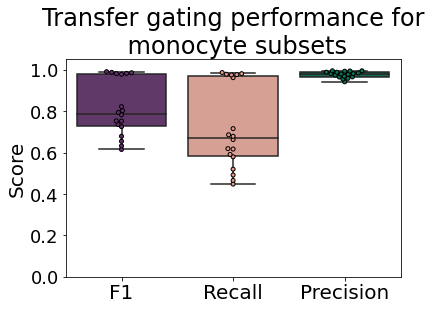

In [33]:
fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores, 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores, y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n monocyte subsets', fontsize=24)
plt.savefig('../figures/performance_transfer_allmono_Hofer.png', bbox_inches='tight')
plt.savefig('../figures/performance_transfer_allmono_Hofer.pdf', bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/1698526908.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


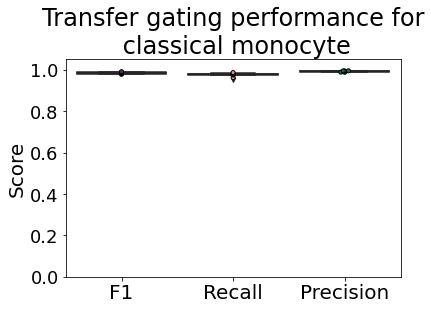

In [34]:
cell_type = 'classical monocyte'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/2312283233.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


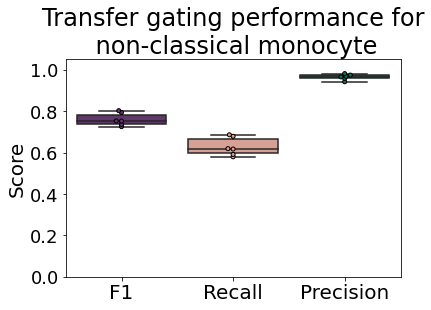

In [35]:
cell_type = 'non-classical monocyte'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

/tmp/ipykernel_751997/3825283088.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, fontsize=18)


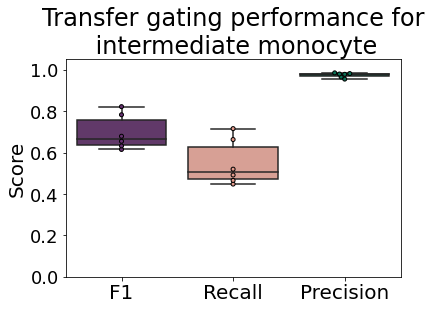

In [36]:
cell_type = 'intermediate monocyte'

fig, ax = plt.subplots()

sns.boxplot(data = transfer_scores.loc[transfer_scores['cell_type']==cell_type], 
            y='value', x='variable', palette=colors)
sns.swarmplot(data =  transfer_scores.loc[transfer_scores['cell_type']==cell_type],
              y='value', x='variable',edgecolor='k', 
              linewidth=1, size=4, palette=colors, )
plt.ylabel('Score', fontsize=20)
plt.ylim([0,1.05])
plt.xlabel('')

labels = [round(item,1) for item in ax.get_yticks()]

ax.set_yticklabels(labels, fontsize=18)
ax.set_xticklabels(['F1', 'Recall', 'Precision'], fontsize=20)

#plt.xticks()

plt.title('Transfer gating performance for\n {}'.format(cell_type), fontsize=24)
plt.savefig('../figures/performance_transfer_{}_Hofer.png'.format(cell_type), bbox_inches='tight')
plt.savefig('../figures/performance_transfer_{}_Hofer.pdf'.format(cell_type), bbox_inches='tight')
plt.show()

In [73]:
scores.loc[scores['cell_type'].isin(clusters)].sort_values(['cell_type', 'score'])

,hierarchy_1,hierarchy_2,hierarchy_3,hierarchy_4,hierarchy_5,score,cell_type,sample
45,0.426540,0.745763,0.724138,0.701754,0.690265,f1,"DC Q1(CD14-, CD5+)",KR
48,0.133333,0.285714,0.254545,0.254545,0.254545,f1,"DC Q1(CD14-, CD5+)",KW
69,0.083333,0.186047,0.186047,0.171875,0.157480,f1,"DC Q1(CD14-, CD5+)",MF
47,0.328467,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",KR
50,0.103448,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",KW
71,0.066667,1.000000,1.000000,1.000000,1.000000,precision,"DC Q1(CD14-, CD5+)",MF
46,0.608108,0.594595,0.567568,0.540541,0.527027,recall,"DC Q1(CD14-, CD5+)",KR
49,0.187500,0.166667,0.145833,0.145833,0.145833,recall,"DC Q1(CD14-, CD5+)",KW
70,0.111111,0.102564,0.102564,0.094017,0.085470,recall,"DC Q1(CD14-, CD5+)",MF
51,0.194529,0.418301,0.418301,0.407895,0.397351,f1,"DC Q3(CD14+, CD5-)",KR


## Postprocess plots to add second scale

Let us read the data and extract the transformation parameters.

In [7]:
adata = sc.read('./../data/Hofer_IMA/mono_merge_annotated.h5ad')

Read transformation from FlowJo files. The parameters used for biexponential scaling are always the same for all three samples.

In [9]:
data_path = './../data/Hofer_IMA/FCS_FJ_files/'
params = pd.read_csv(data_path + 'workspace_hofer_params_KR full.fcs_0000000000790217.csv', 
                     index_col = 0)

In [10]:
rename_col = [idx.split('parameters.')[-1] for idx in params.columns.values]

In [11]:
params.columns = rename_col

Use only 'area' parameter.

In [12]:
params = params.loc[[channel.endswith('-A') for channel in params.index]]

Create dictionary for index renaming in the params, assuming that the `channel_data` have the same order.

In [14]:
channel_renames = dict(zip(adata.var['channel'].values, 
                           adata.var['marker'].values))

In [15]:
params.index = params.index.map(channel_renames)

Implement inverse function for the biexponential transformation as implemented in FlowKit. This is based on the bi-exp lookup table (LUT).

In [52]:
lut_func, inverse_lut_func = generate_lut_func(
                         neg=params['neg'][0], 
                         width_basis=params['widthBasis'][0], 
                         pos=params['pos'][0], 
                         max_value=params['maxValue'][0])

In [53]:
add_hull_path = os.path.join('./../', 'data', 'performance_test', 'convex_gating', 'Hofer_data', 'cell_types')
if not os.path.exists(add_hull_path):
    os.mkdir(add_hull_path)


In [54]:
dirIDs = os.listdir(add_hull_path)

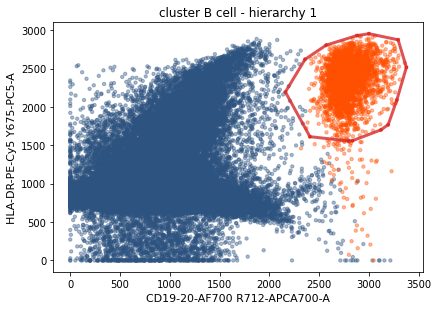

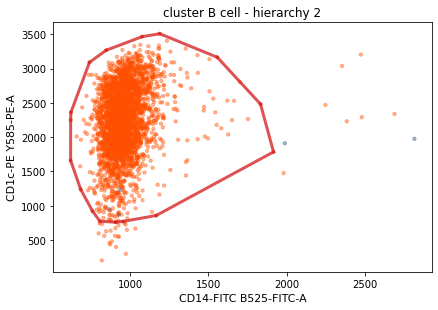

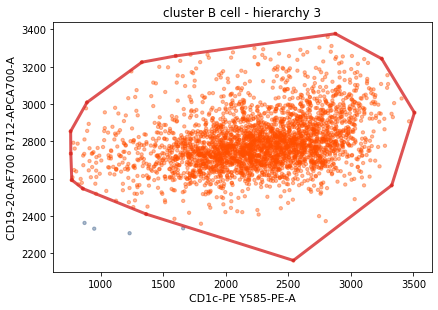

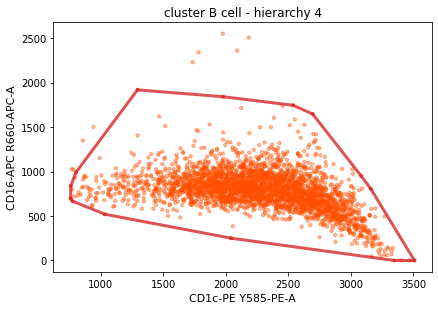

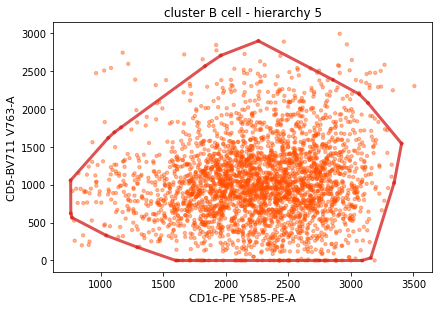

nr_targets :3115
nr_non_targets :46885
nr_targets :3040
nr_non_targets :6


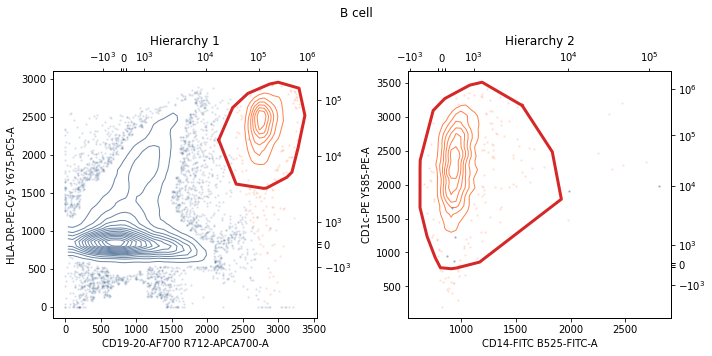

nr_targets :3115
nr_non_targets :46885
nr_targets :3040
nr_non_targets :6


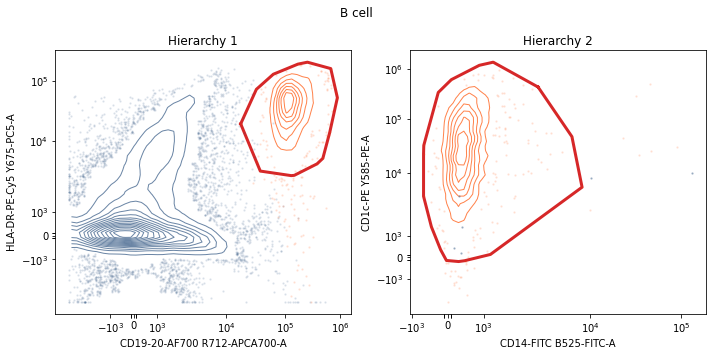

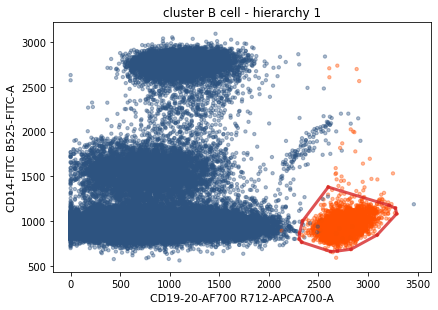

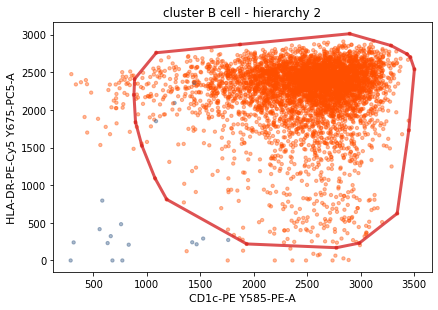

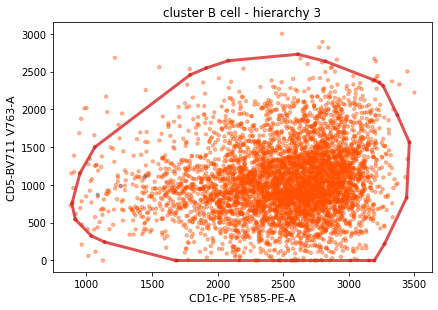

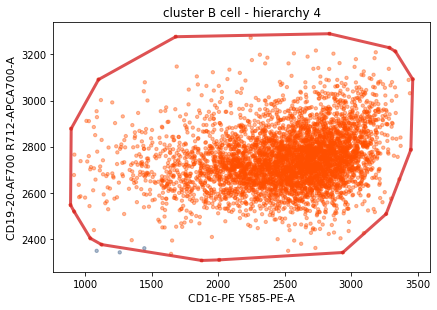

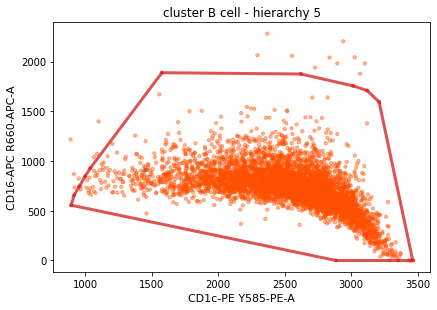

nr_targets :4899
nr_non_targets :45101
nr_targets :4853
nr_non_targets :17


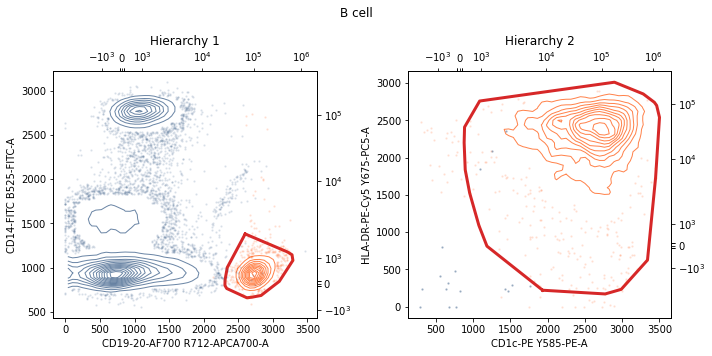

nr_targets :4899
nr_non_targets :45101
nr_targets :4853
nr_non_targets :17


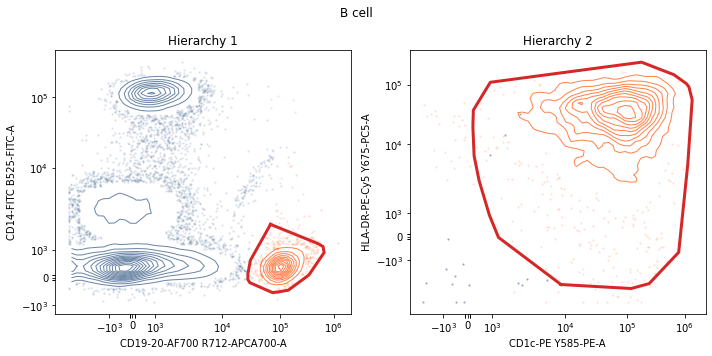

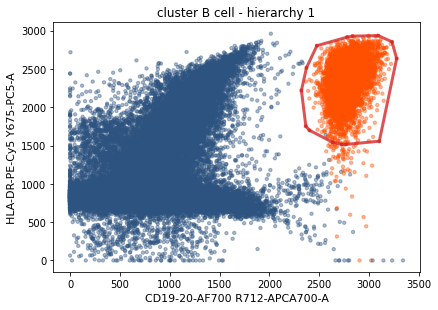

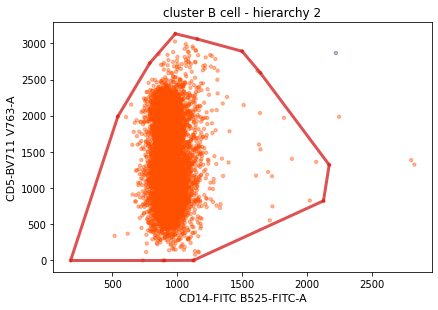

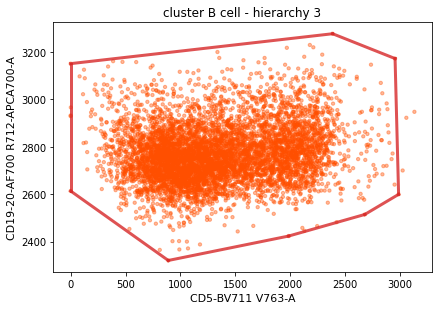

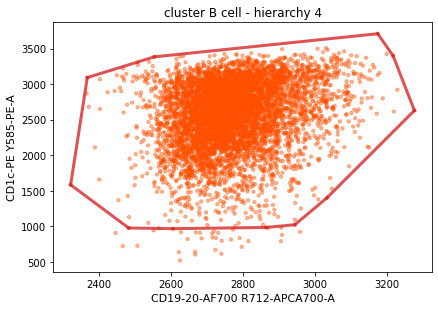

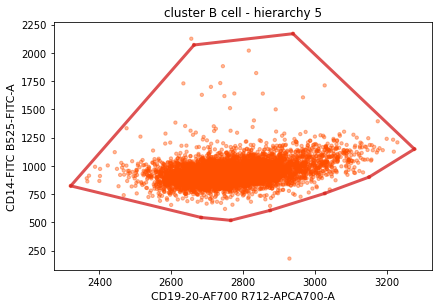

nr_targets :6332
nr_non_targets :43668
nr_targets :6265
nr_non_targets :1


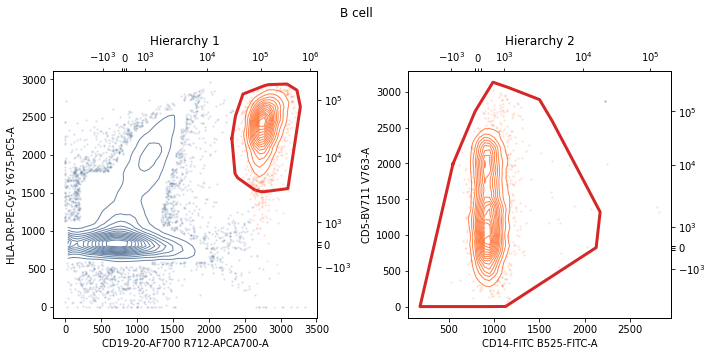

nr_targets :6332
nr_non_targets :43668
nr_targets :6265
nr_non_targets :1


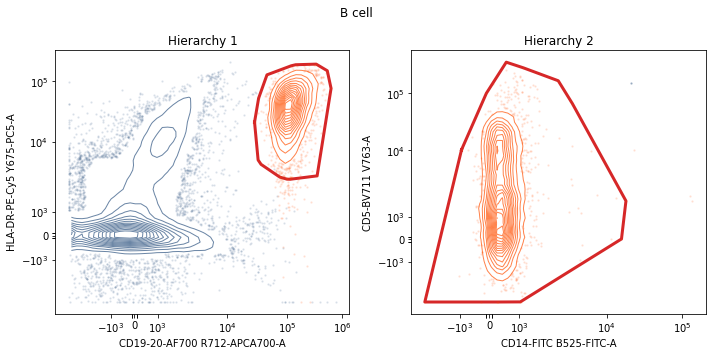

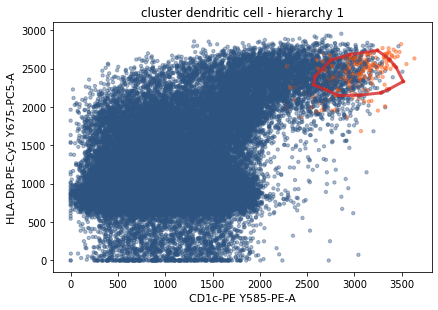

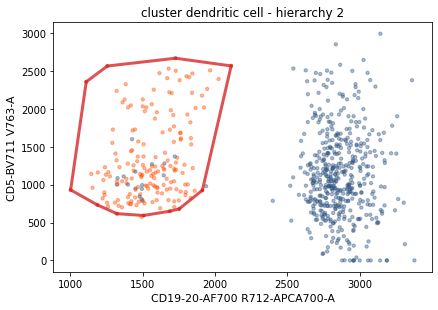

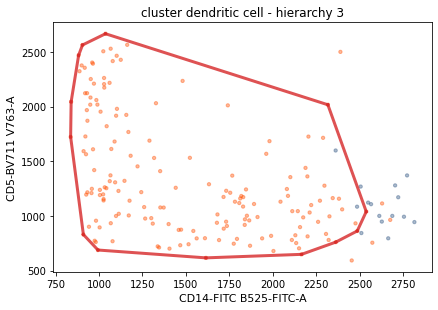

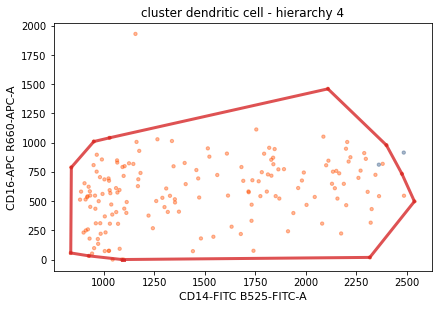

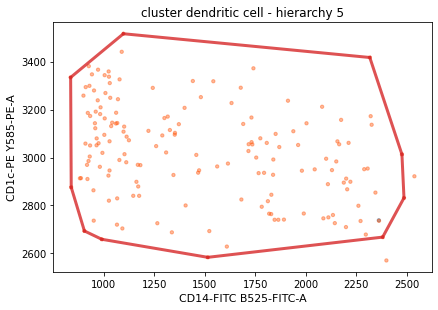

nr_targets :238
nr_non_targets :49762
nr_targets :173
nr_non_targets :491
nr_targets :172
nr_non_targets :15
nr_targets :167
nr_non_targets :2


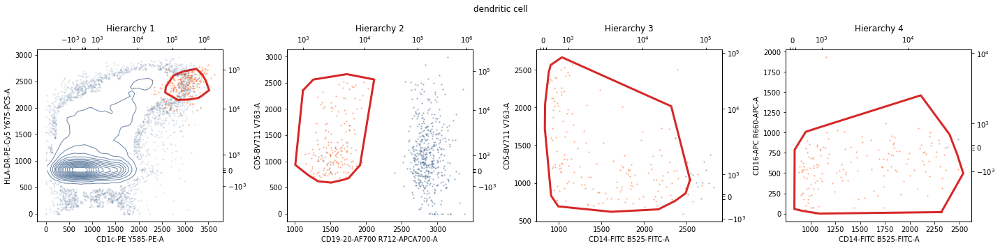

nr_targets :238
nr_non_targets :49762
nr_targets :173
nr_non_targets :491
nr_targets :172
nr_non_targets :15
nr_targets :167
nr_non_targets :2


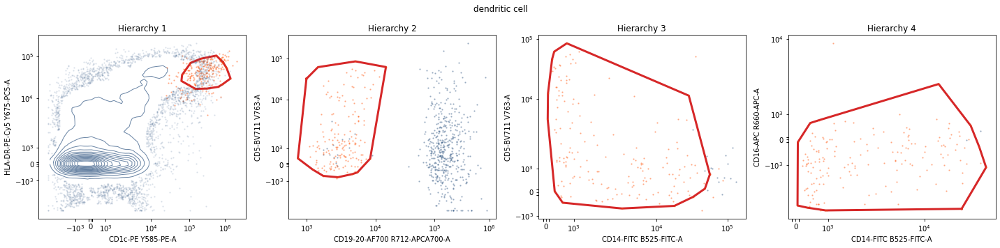

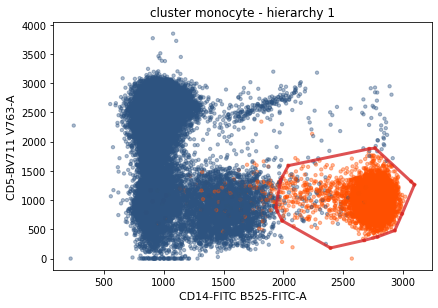

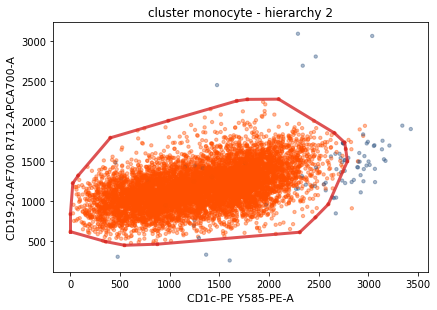

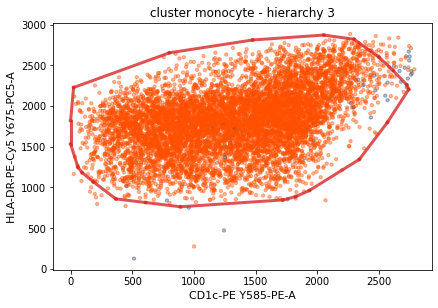

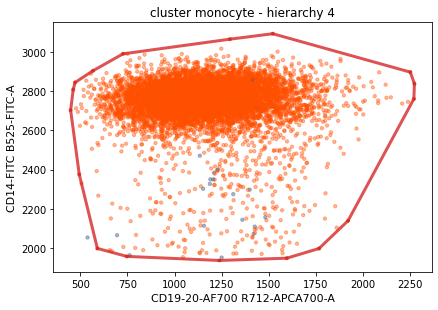

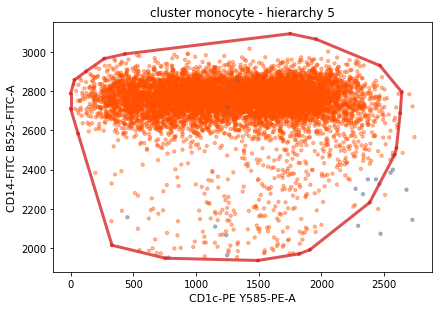

nr_targets :8062
nr_non_targets :41938
nr_targets :7933
nr_non_targets :81
nr_targets :7925
nr_non_targets :36


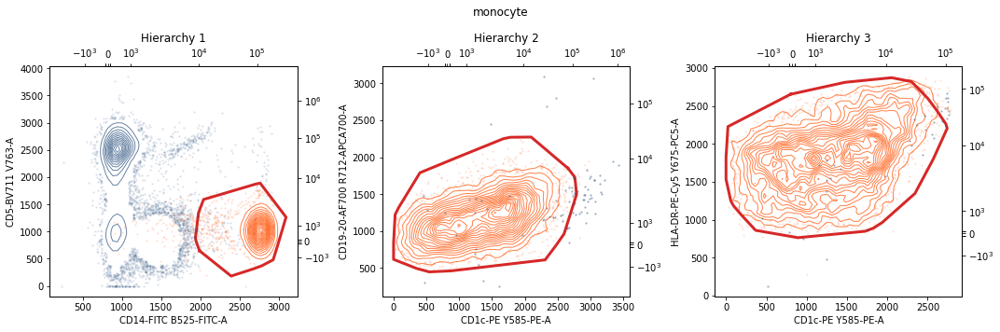

nr_targets :8062
nr_non_targets :41938
nr_targets :7933
nr_non_targets :81
nr_targets :7925
nr_non_targets :36


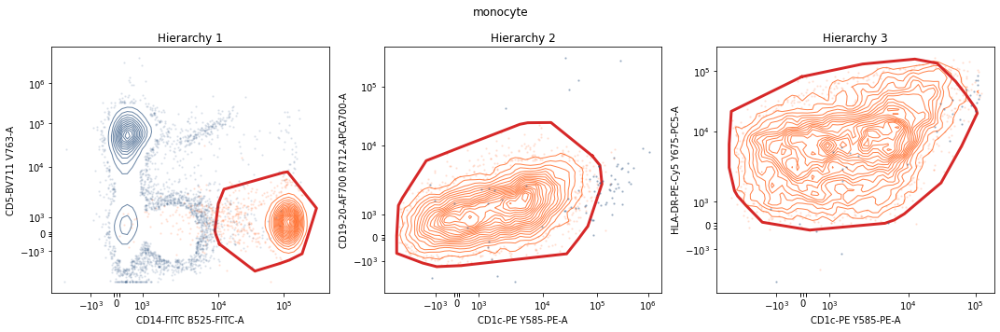

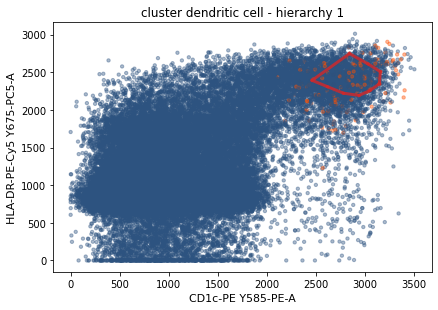

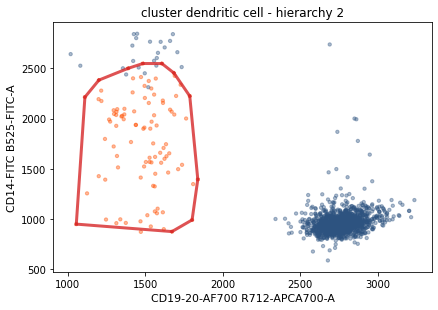

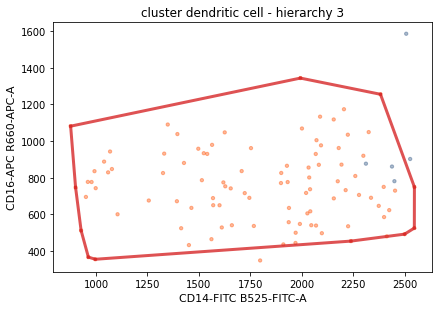

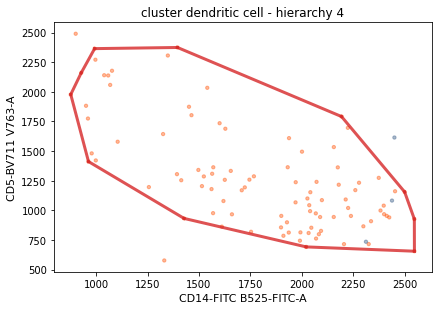

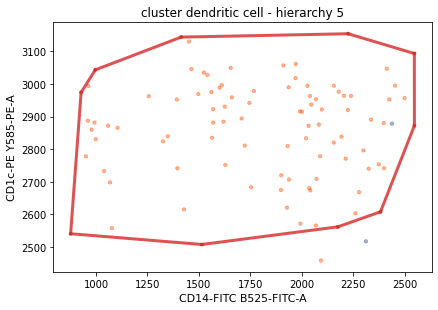

nr_targets :194
nr_non_targets :49806
nr_targets :98
nr_non_targets :1295
nr_targets :97
nr_non_targets :5


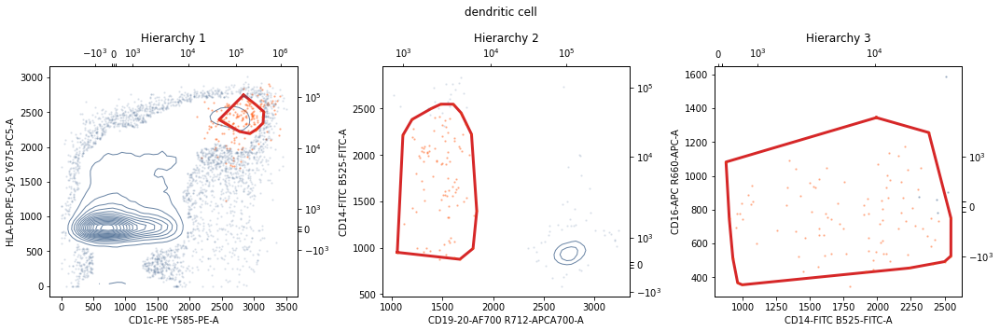

nr_targets :194
nr_non_targets :49806
nr_targets :98
nr_non_targets :1295
nr_targets :97
nr_non_targets :5


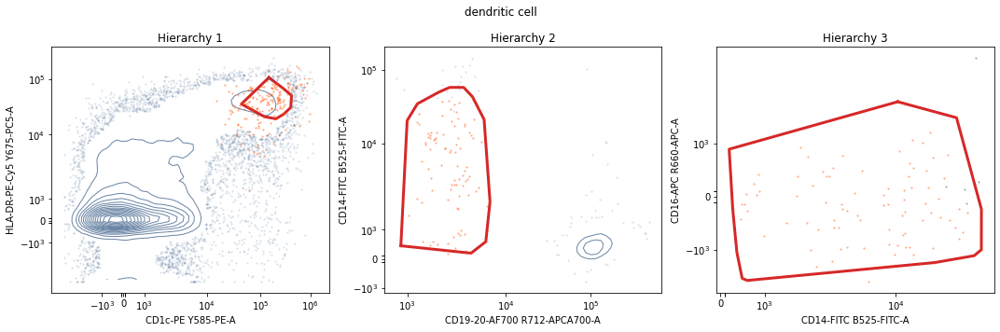

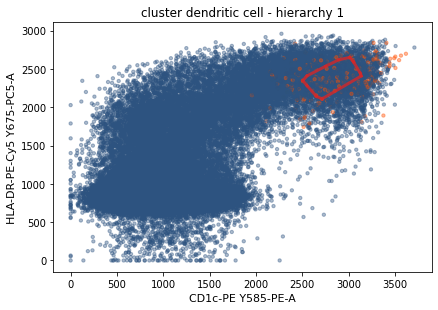

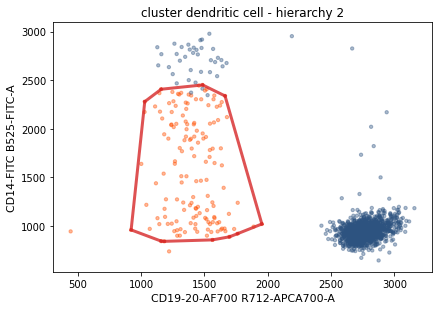

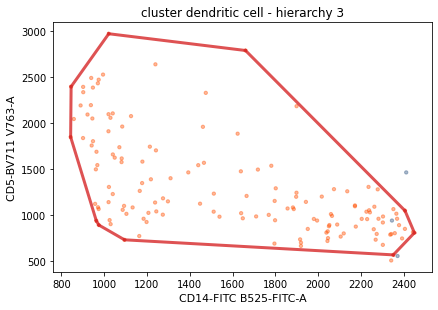

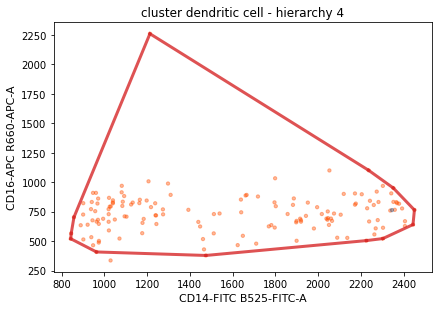

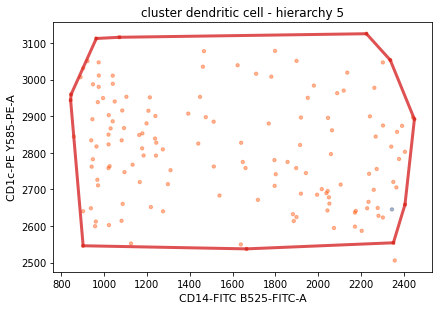

nr_targets :347
nr_non_targets :49653
nr_targets :148
nr_non_targets :1432
nr_targets :146
nr_non_targets :3


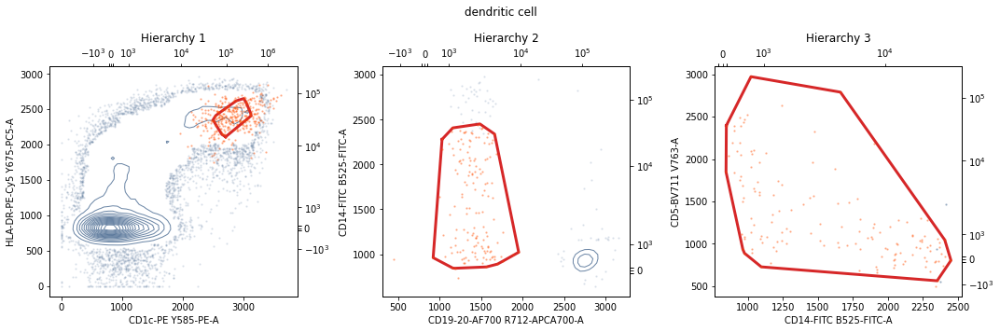

nr_targets :347
nr_non_targets :49653
nr_targets :148
nr_non_targets :1432
nr_targets :146
nr_non_targets :3


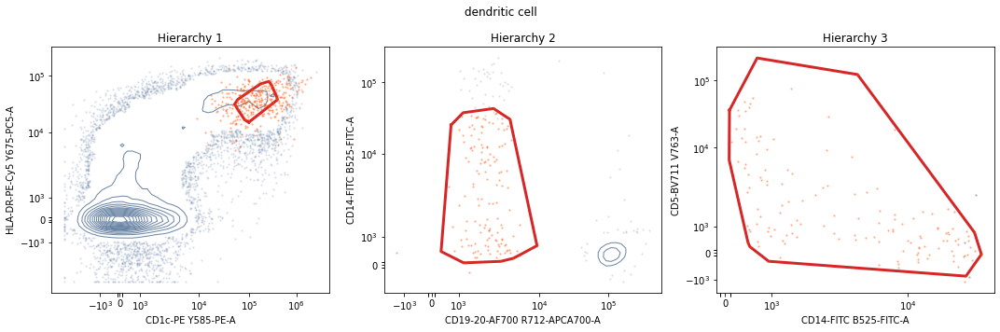

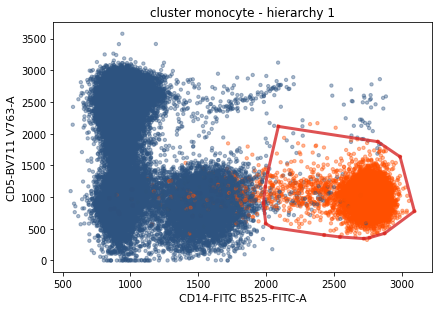

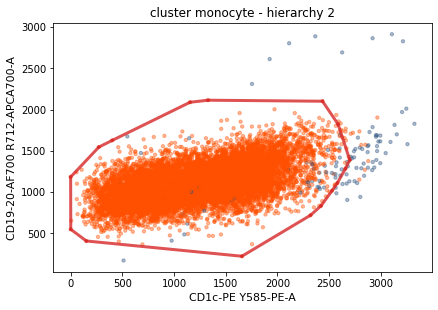

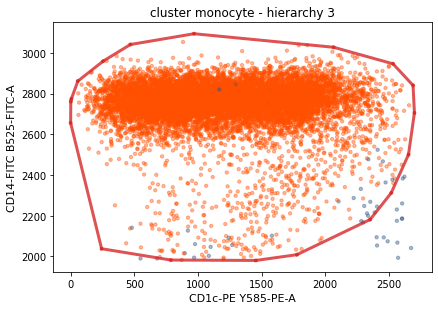

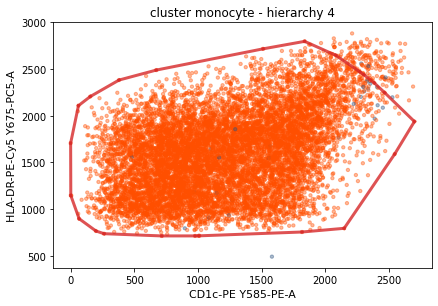

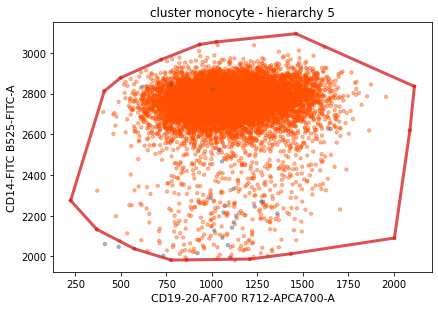

nr_targets :10420
nr_non_targets :39580
nr_targets :10216
nr_non_targets :107
nr_targets :10197
nr_non_targets :48
nr_targets :10197
nr_non_targets :32


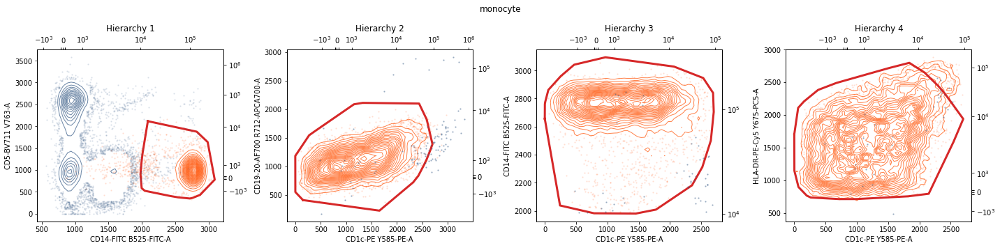

nr_targets :10420
nr_non_targets :39580
nr_targets :10216
nr_non_targets :107
nr_targets :10197
nr_non_targets :48
nr_targets :10197
nr_non_targets :32


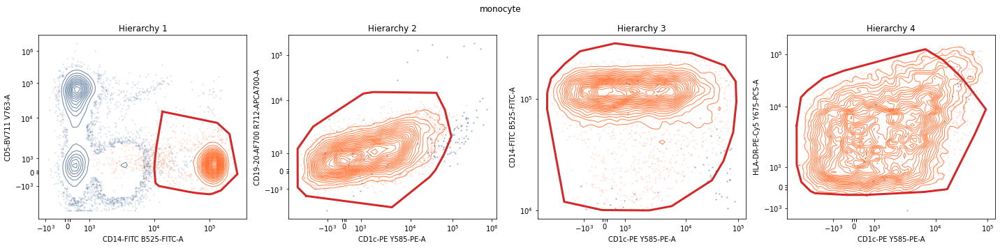

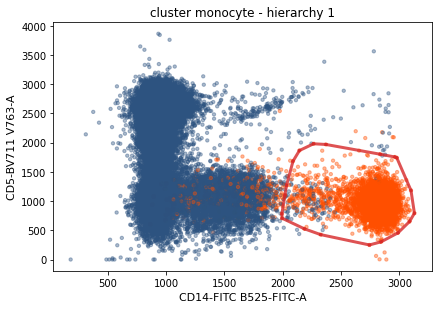

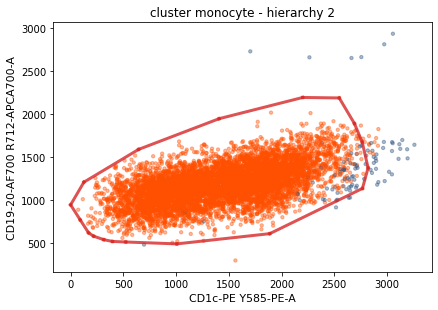

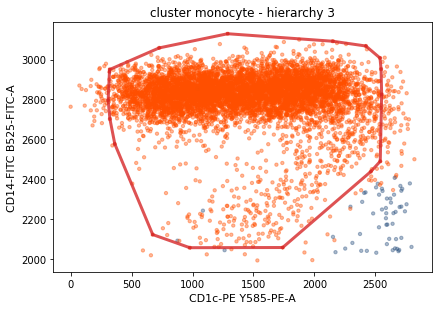

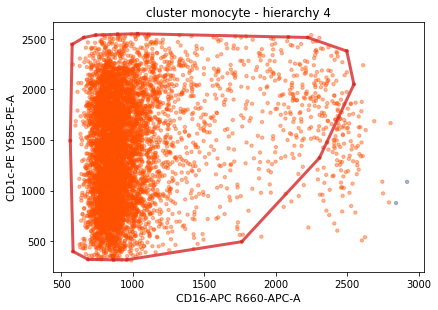

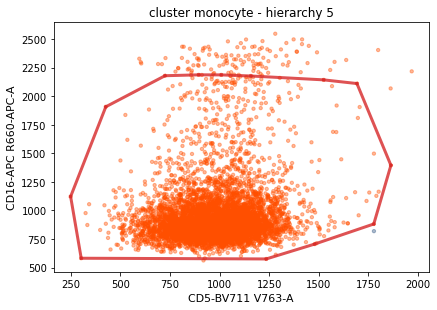

nr_targets :7143
nr_non_targets :42857
nr_targets :6795
nr_non_targets :94
nr_targets :6782
nr_non_targets :55


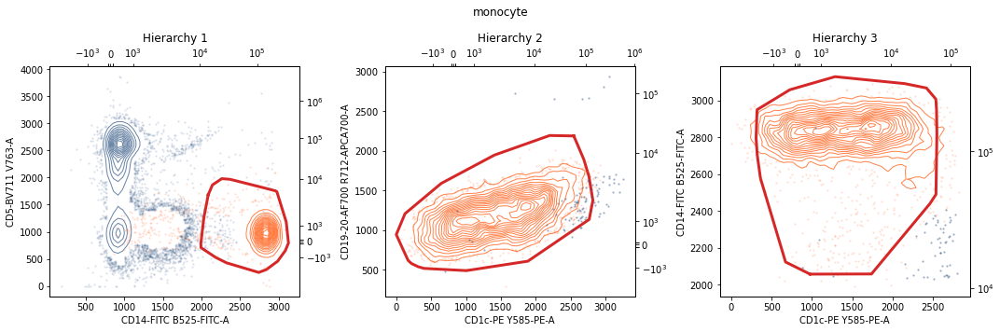

nr_targets :7143
nr_non_targets :42857
nr_targets :6795
nr_non_targets :94
nr_targets :6782
nr_non_targets :55


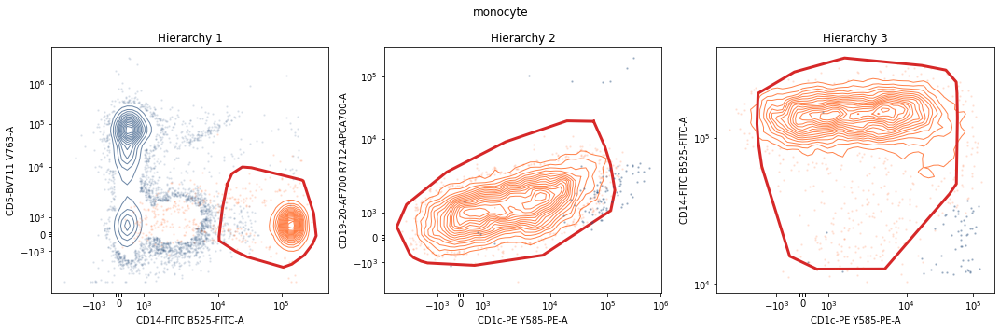

In [55]:
for cluster_key in dirIDs:
    if not cluster_key.startswith('cluster'):
        continue
    meta_info_path = os.path.join(add_hull_path, cluster_key, 'meta_info.npy')
    meta_info = np.load(meta_info_path,allow_pickle=True).item()

    population,population_path,base_df = prepare_contour_plot(meta_info = meta_info,
                                                          add_hull_path = add_hull_path,
                                                          run_ID =0)
    #read performance summary to obtain number of clusters
    per_summary = pd.read_csv(os.path.join(add_hull_path, cluster_key, 'performance_summary.csv'))
    num_hierarchies = np.min([per_summary['hierarchy'].max() + 1, 5])
    run_ID =0
    for mode in ['both', 'replace']:
        path = os.path.join(population_path, f'{cluster_key}')
        save = os.path.join(population_path, f'{cluster_key}',
                    population + f'_gating_strategy_{mode}.pdf')
        save_png = os.path.join(population_path, f'{cluster_key}', population + f'_gating_strategy_{mode}.png')
        if not os.path.exists(path):
            os.makedirs(path)
        contour_lines_separate_outliers(meta_info, run_ID, base_df, population,population_path,
                    num_hierarchies=num_hierarchies, pop_min=500,
                                        mode=mode, transform_func=lut_func, inverse_transform_func=inverse_lut_func,
                        save = save,save_png=save_png)

In [56]:
add_hull_path = os.path.join('./../', 'data', 'performance_test', 'convex_gating', 'Hofer_data', 'cell_types_lvl2')
if not os.path.exists(add_hull_path):
    os.mkdir(add_hull_path)


In [57]:
dirIDs = os.listdir(add_hull_path)

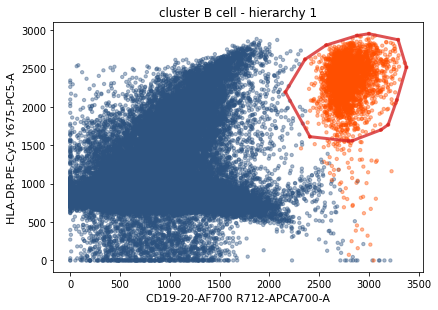

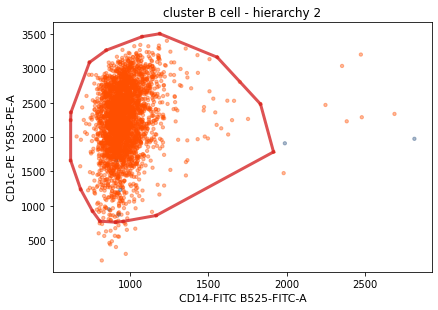

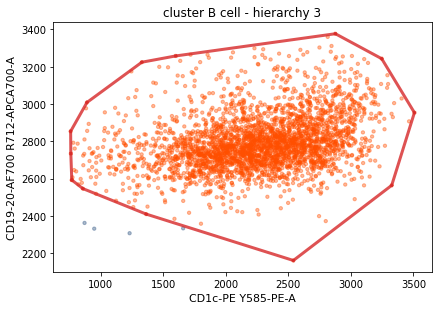

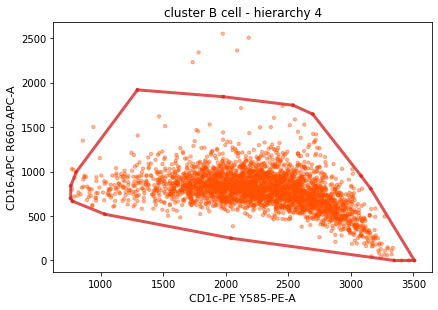

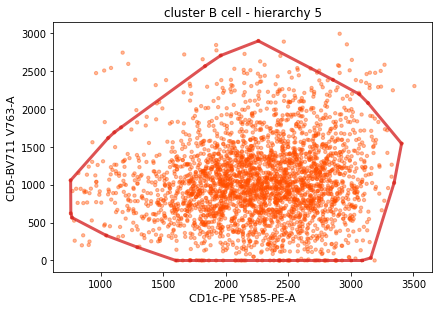

nr_targets :3115
nr_non_targets :46885
nr_targets :3040
nr_non_targets :6


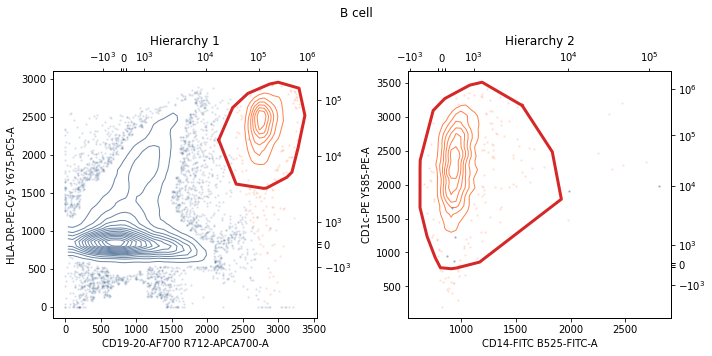

nr_targets :3115
nr_non_targets :46885
nr_targets :3040
nr_non_targets :6


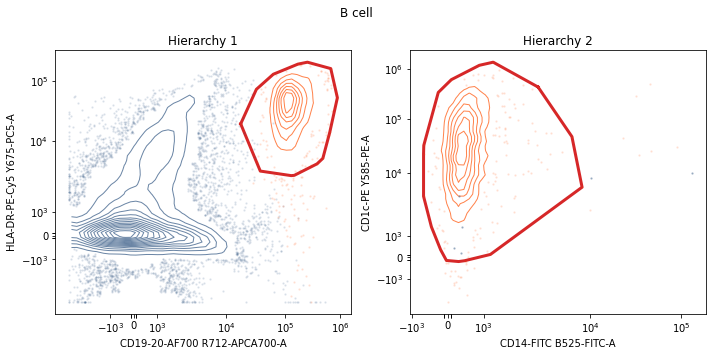

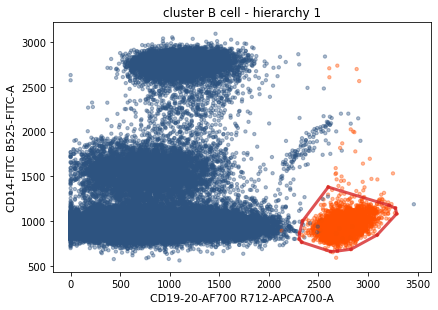

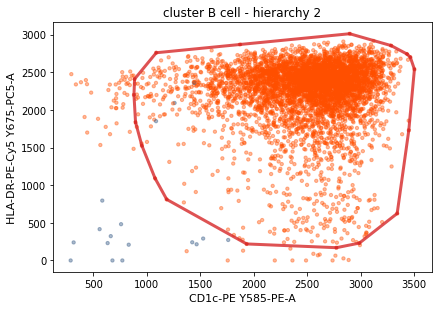

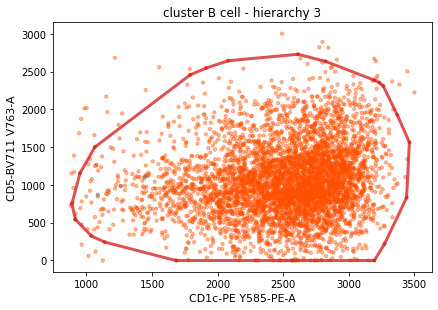

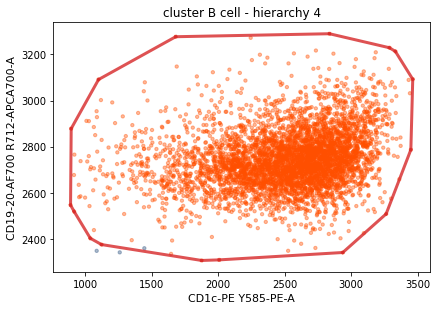

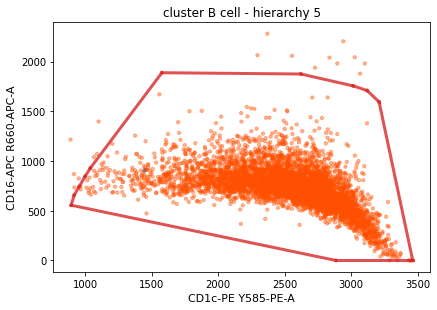

nr_targets :4899
nr_non_targets :45101
nr_targets :4853
nr_non_targets :17


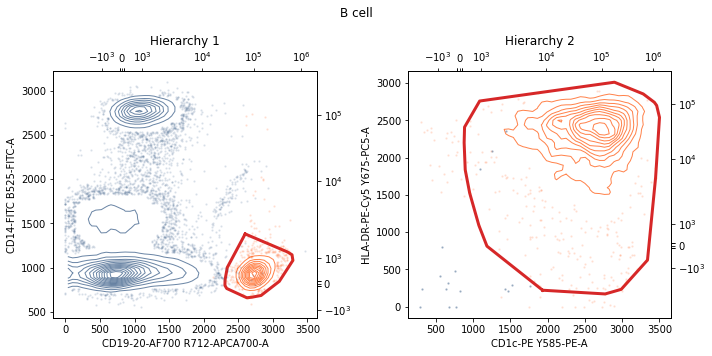

nr_targets :4899
nr_non_targets :45101
nr_targets :4853
nr_non_targets :17


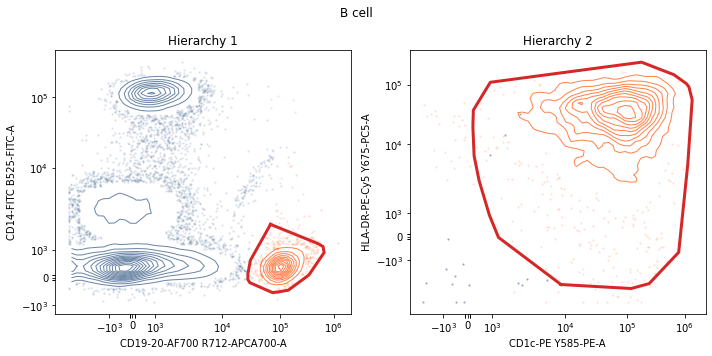

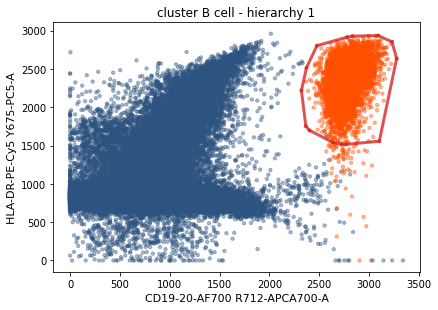

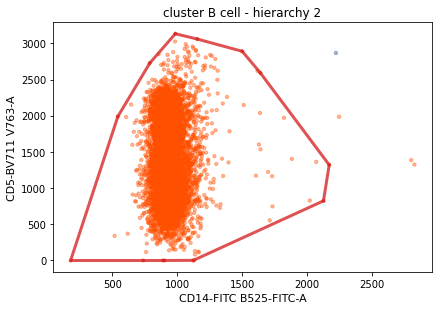

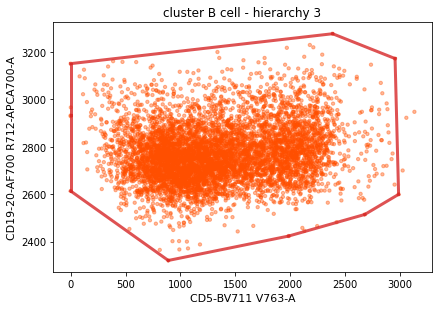

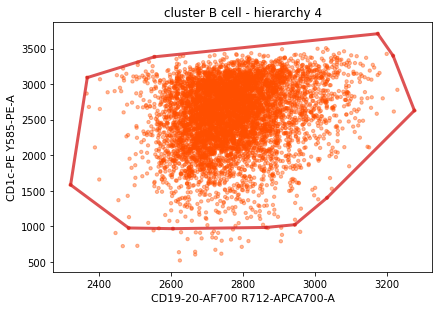

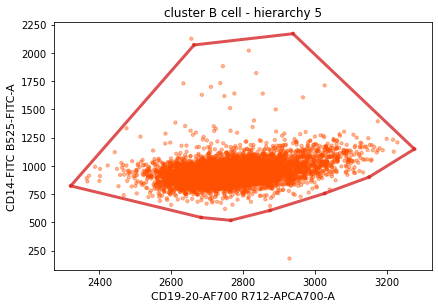

nr_targets :6332
nr_non_targets :43668
nr_targets :6265
nr_non_targets :1


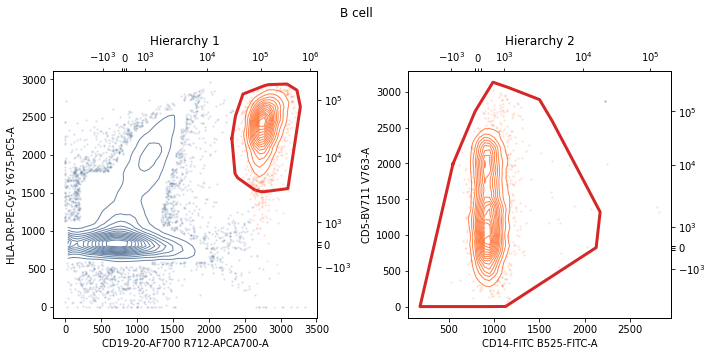

nr_targets :6332
nr_non_targets :43668
nr_targets :6265
nr_non_targets :1


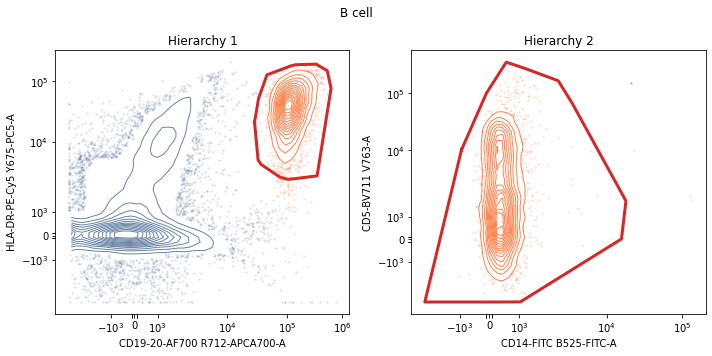

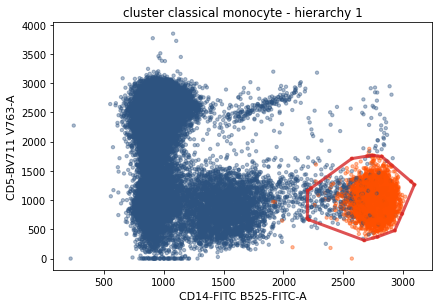

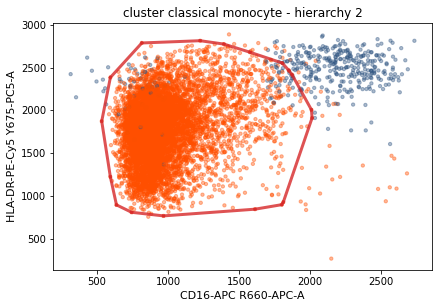

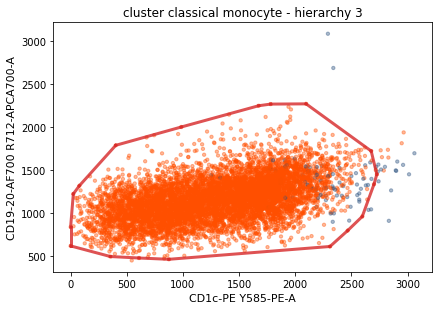

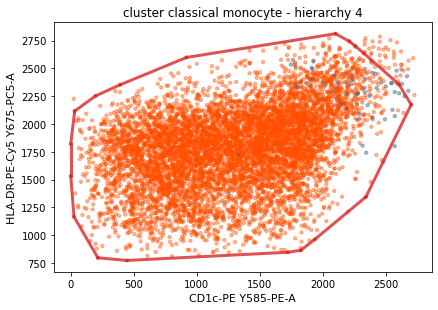

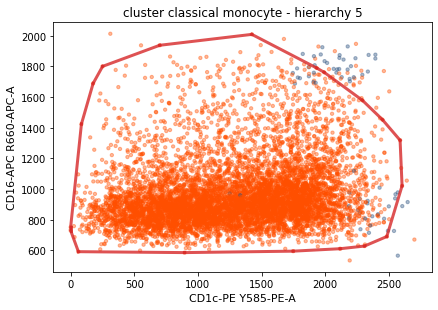

nr_targets :7438
nr_non_targets :42562
nr_targets :7428
nr_non_targets :407
nr_targets :7385
nr_non_targets :90
nr_targets :7377
nr_non_targets :72


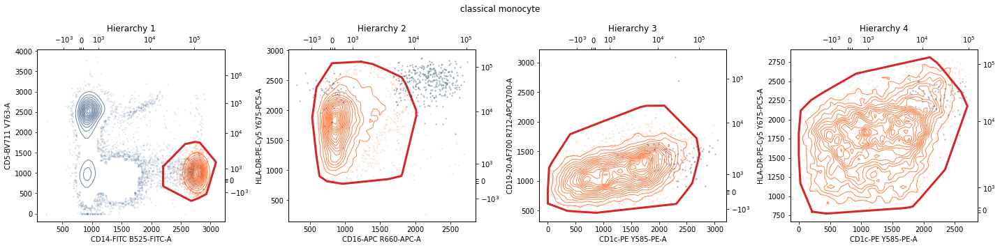

nr_targets :7438
nr_non_targets :42562
nr_targets :7428
nr_non_targets :407
nr_targets :7385
nr_non_targets :90
nr_targets :7377
nr_non_targets :72


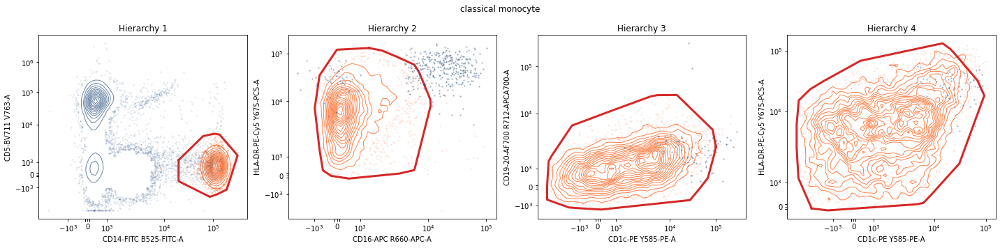

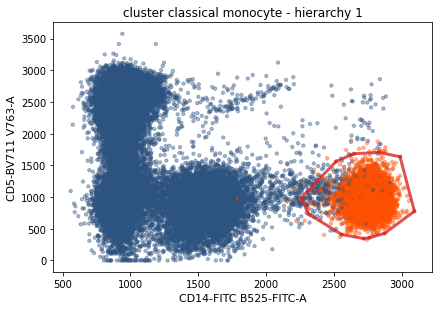

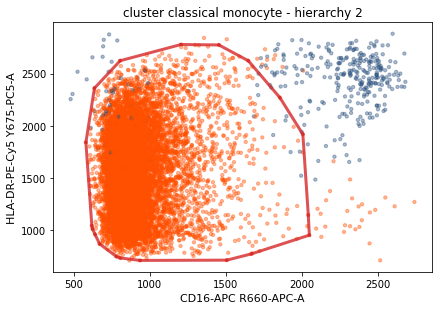

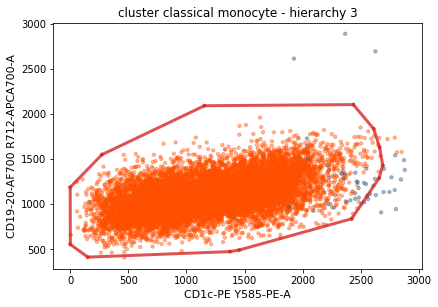

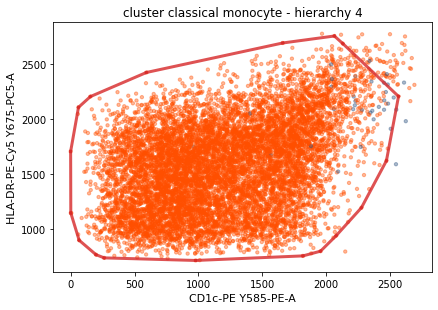

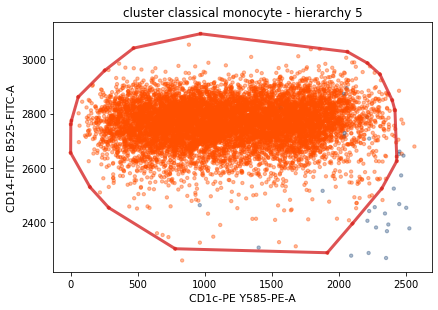

nr_targets :9683
nr_non_targets :40317
nr_targets :9650
nr_non_targets :344
nr_targets :9612
nr_non_targets :54
nr_targets :9606
nr_non_targets :35


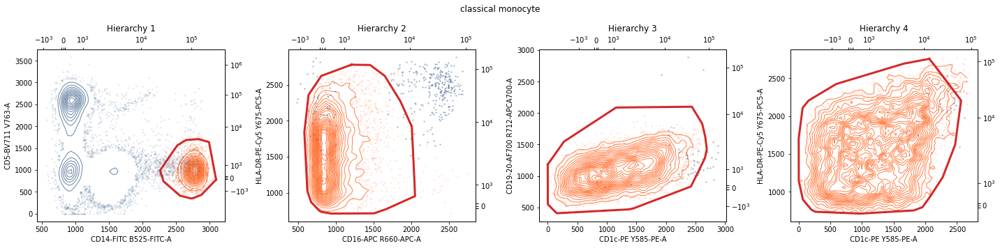

nr_targets :9683
nr_non_targets :40317
nr_targets :9650
nr_non_targets :344
nr_targets :9612
nr_non_targets :54
nr_targets :9606
nr_non_targets :35


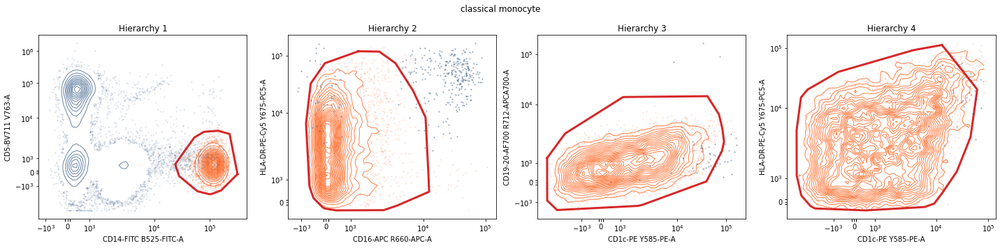

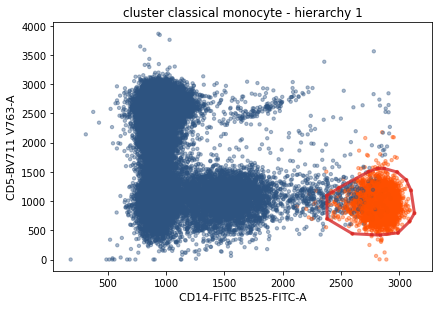

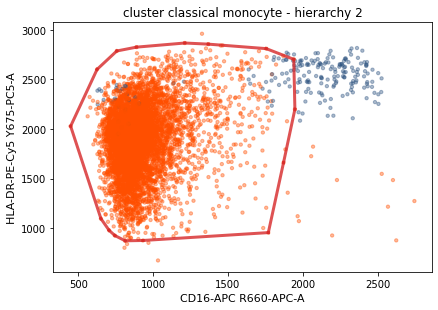

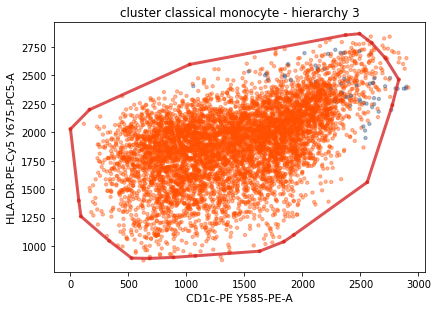

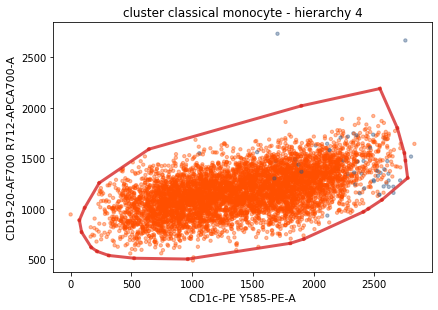

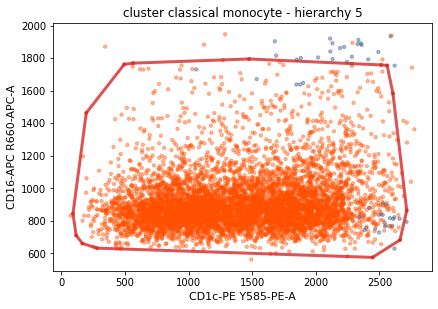

nr_targets :6390
nr_non_targets :43610
nr_targets :6340
nr_non_targets :203
nr_targets :6323
nr_non_targets :56


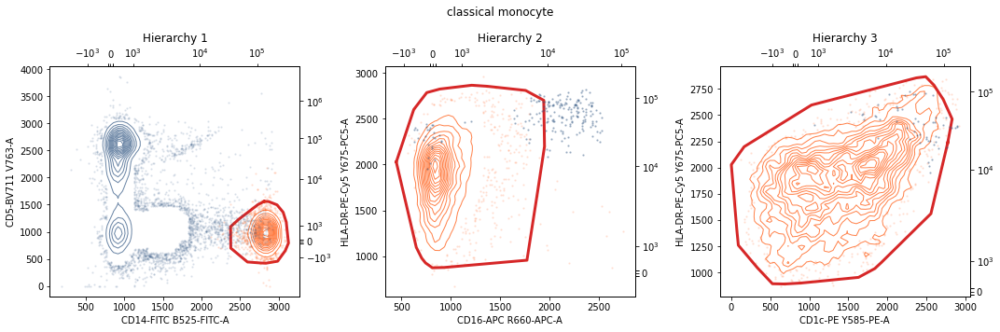

nr_targets :6390
nr_non_targets :43610
nr_targets :6340
nr_non_targets :203
nr_targets :6323
nr_non_targets :56


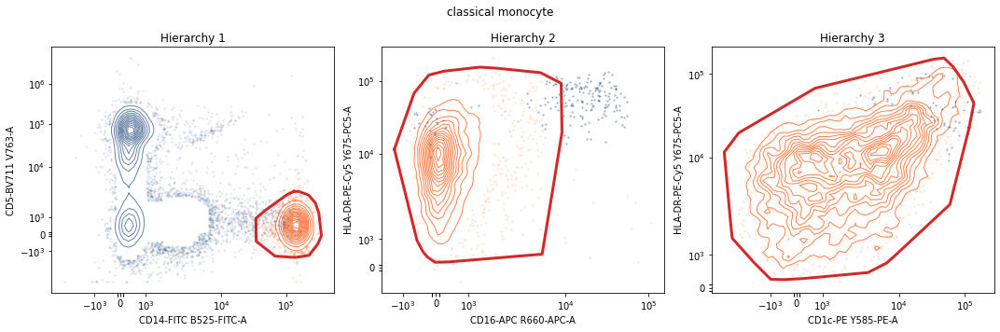

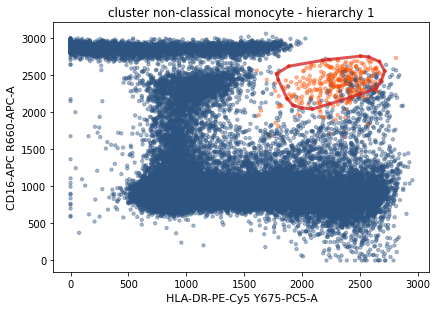

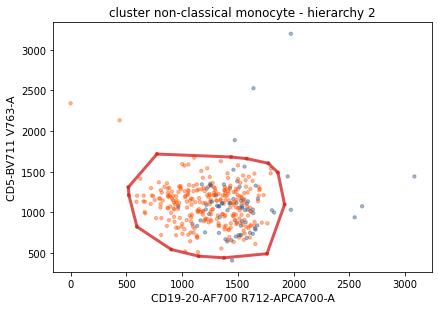

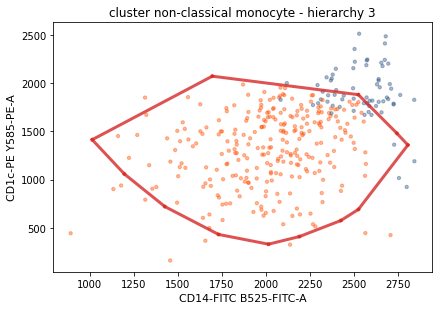

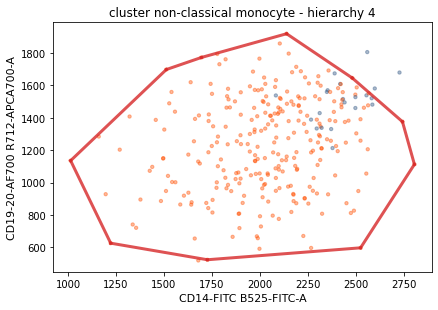

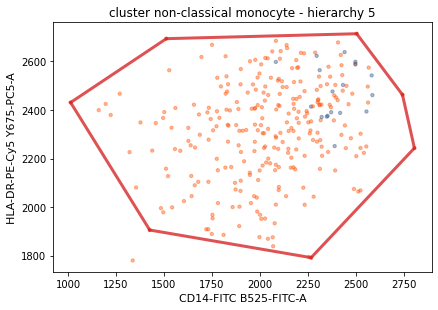

nr_targets :325
nr_non_targets :49675
nr_targets :282
nr_non_targets :75
nr_targets :280
nr_non_targets :66
nr_targets :270
nr_non_targets :21
nr_targets :269
nr_non_targets :18


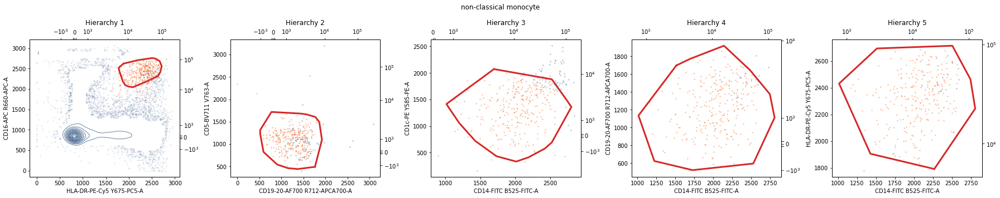

nr_targets :325
nr_non_targets :49675
nr_targets :282
nr_non_targets :75
nr_targets :280
nr_non_targets :66
nr_targets :270
nr_non_targets :21
nr_targets :269
nr_non_targets :18


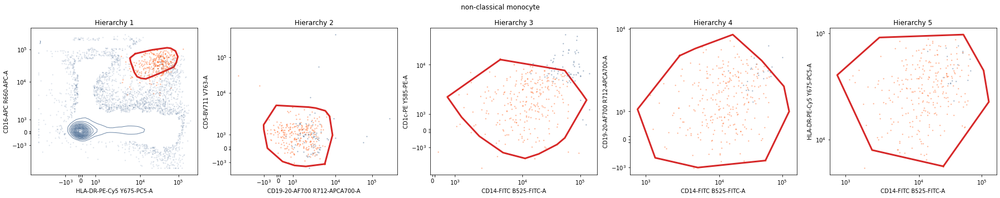

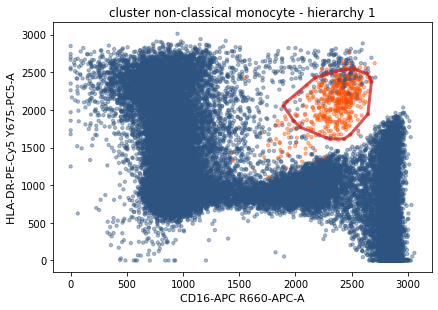

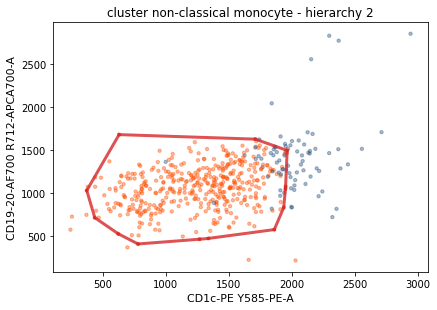

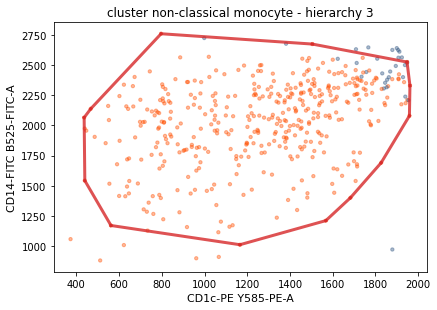

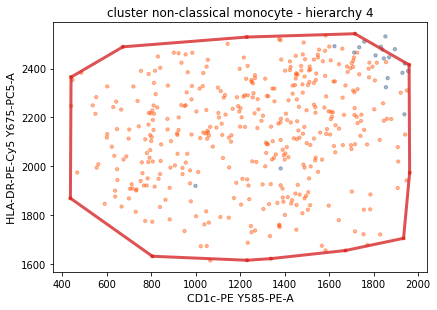

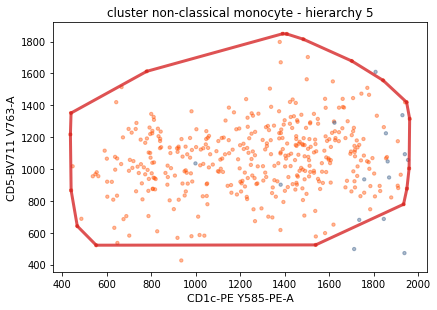

nr_targets :489
nr_non_targets :49511
nr_targets :421
nr_non_targets :78
nr_targets :414
nr_non_targets :29
nr_targets :409
nr_non_targets :19
nr_targets :408
nr_non_targets :15


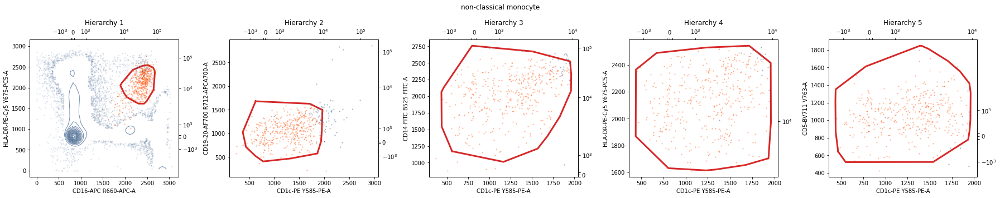

nr_targets :489
nr_non_targets :49511
nr_targets :421
nr_non_targets :78
nr_targets :414
nr_non_targets :29
nr_targets :409
nr_non_targets :19
nr_targets :408
nr_non_targets :15


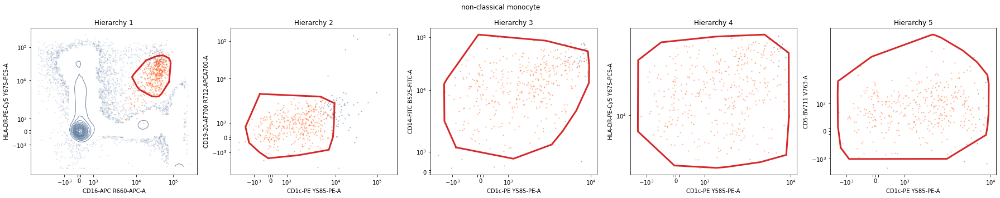

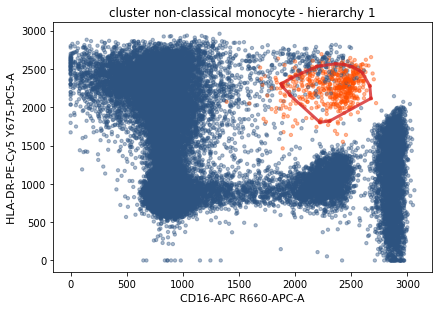

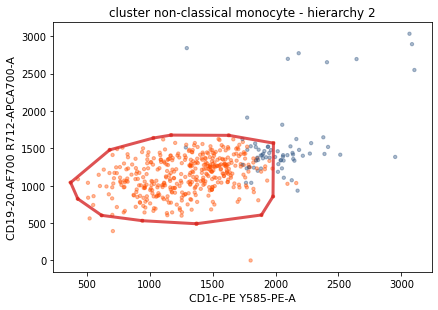

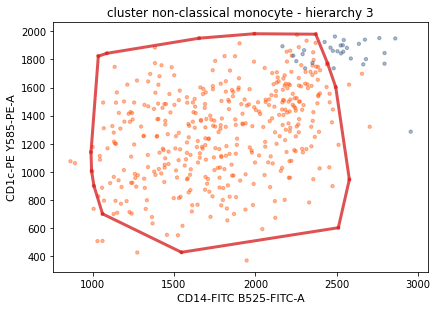

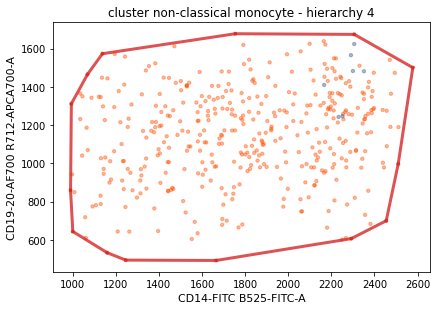

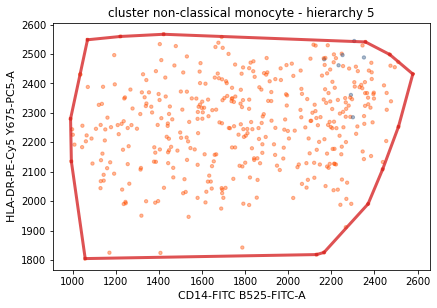

nr_targets :519
nr_non_targets :49481
nr_targets :423
nr_non_targets :68
nr_targets :418
nr_non_targets :29
nr_targets :408
nr_non_targets :7
nr_targets :408
nr_non_targets :7


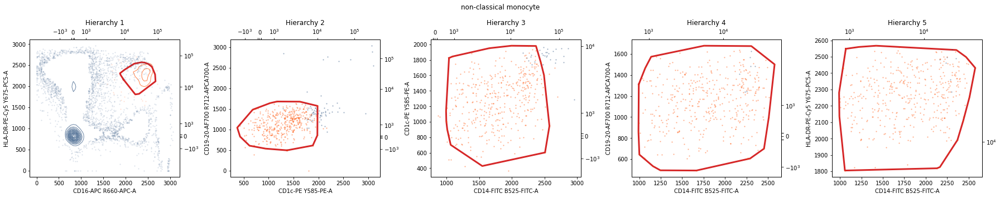

nr_targets :519
nr_non_targets :49481
nr_targets :423
nr_non_targets :68
nr_targets :418
nr_non_targets :29
nr_targets :408
nr_non_targets :7
nr_targets :408
nr_non_targets :7


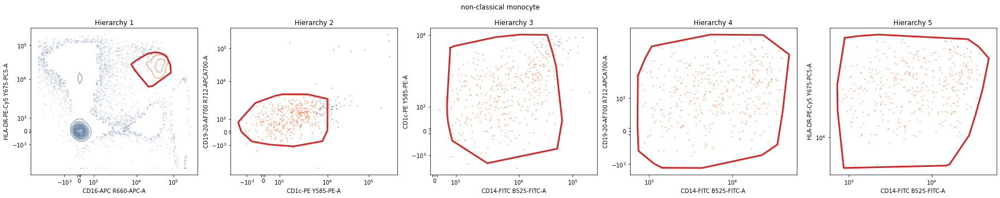

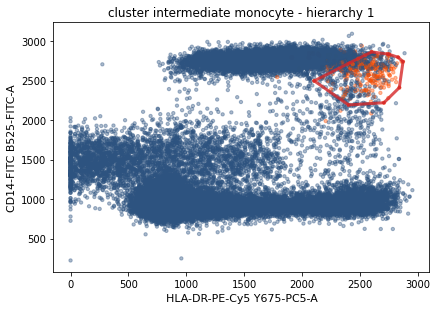

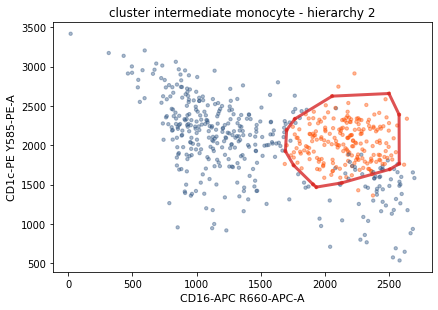

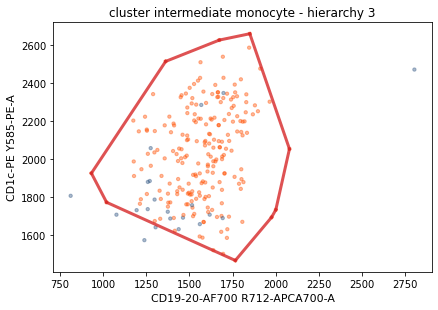

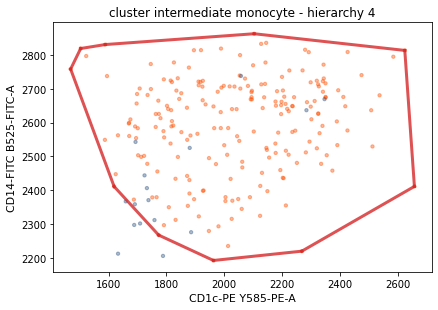

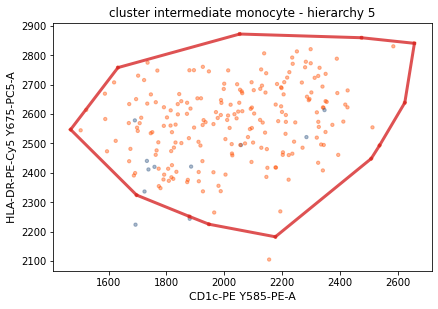

nr_targets :270
nr_non_targets :49730
nr_targets :219
nr_non_targets :366
nr_targets :212
nr_non_targets :21
nr_targets :212
nr_non_targets :16
nr_targets :212
nr_non_targets :11


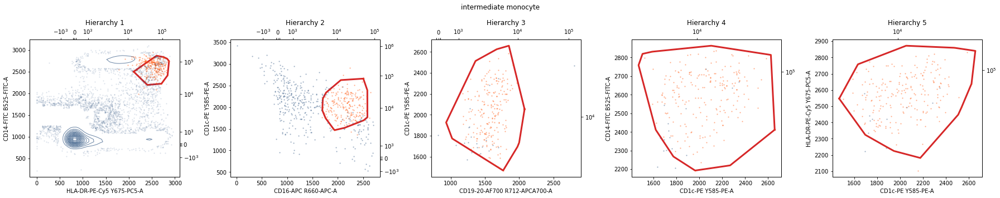

nr_targets :270
nr_non_targets :49730
nr_targets :219
nr_non_targets :366
nr_targets :212
nr_non_targets :21
nr_targets :212
nr_non_targets :16
nr_targets :212
nr_non_targets :11


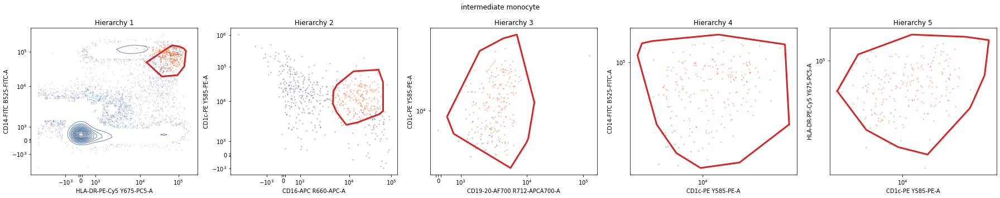

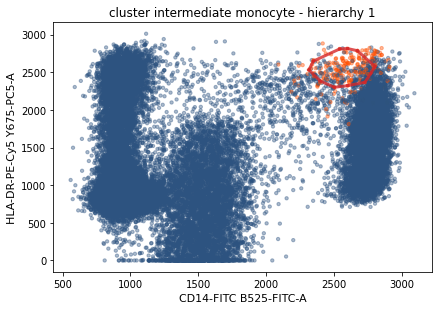

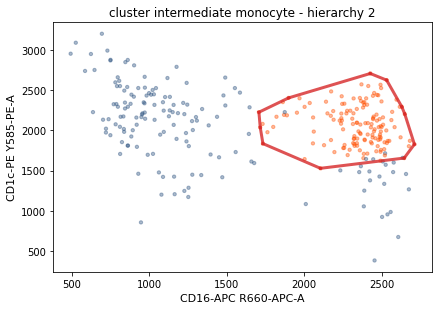

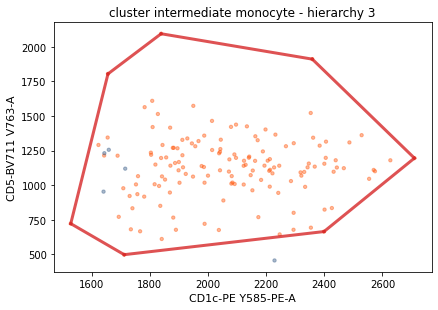

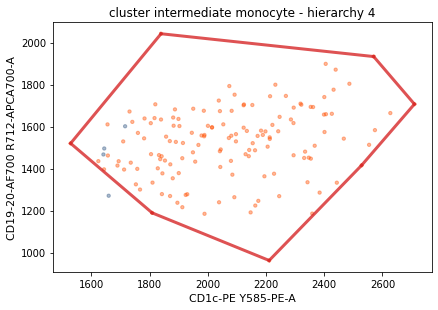

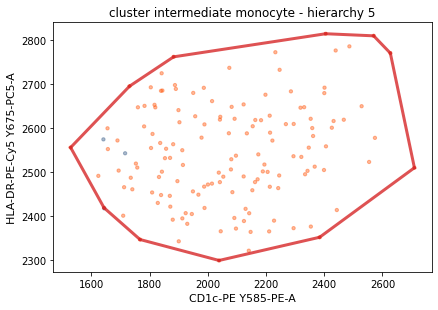

nr_targets :225
nr_non_targets :49775
nr_targets :144
nr_non_targets :149
nr_targets :144
nr_non_targets :5
nr_targets :144
nr_non_targets :4
nr_targets :144
nr_non_targets :3


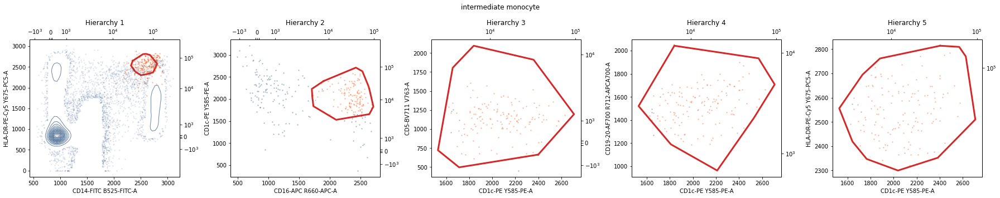

nr_targets :225
nr_non_targets :49775
nr_targets :144
nr_non_targets :149
nr_targets :144
nr_non_targets :5
nr_targets :144
nr_non_targets :4
nr_targets :144
nr_non_targets :3


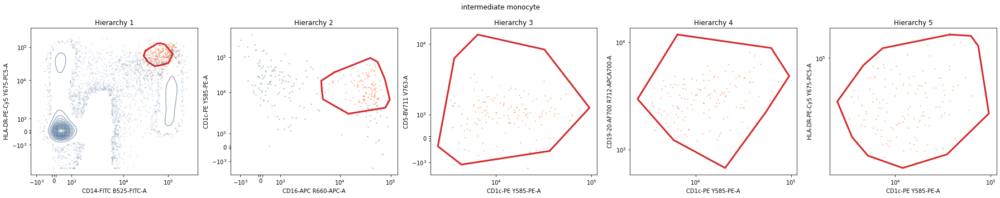

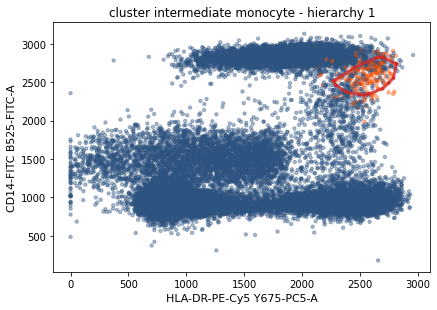

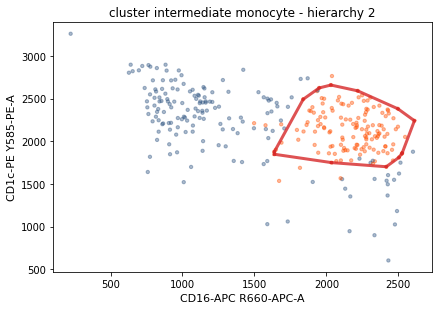

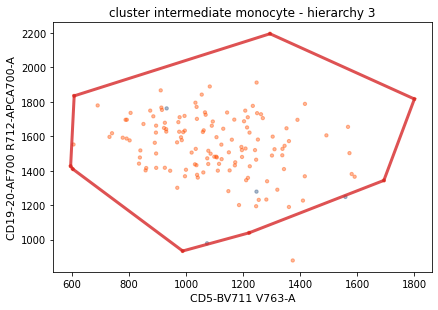

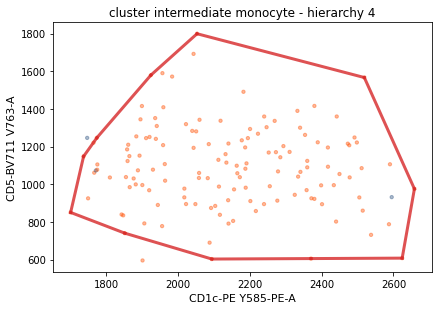

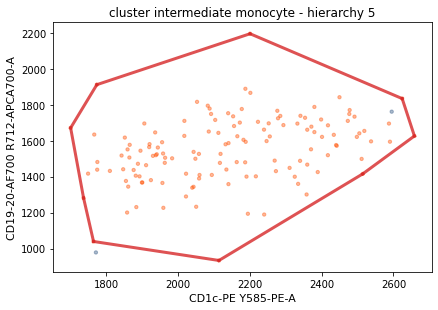

nr_targets :209
nr_non_targets :49791
nr_targets :144
nr_non_targets :159
nr_targets :137
nr_non_targets :4


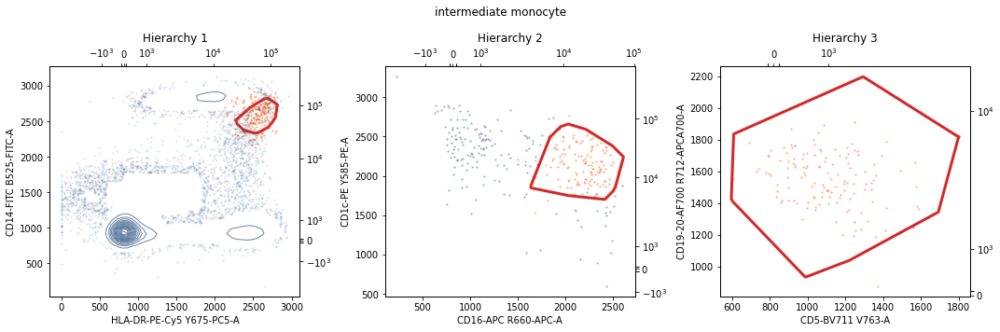

nr_targets :209
nr_non_targets :49791
nr_targets :144
nr_non_targets :159
nr_targets :137
nr_non_targets :4


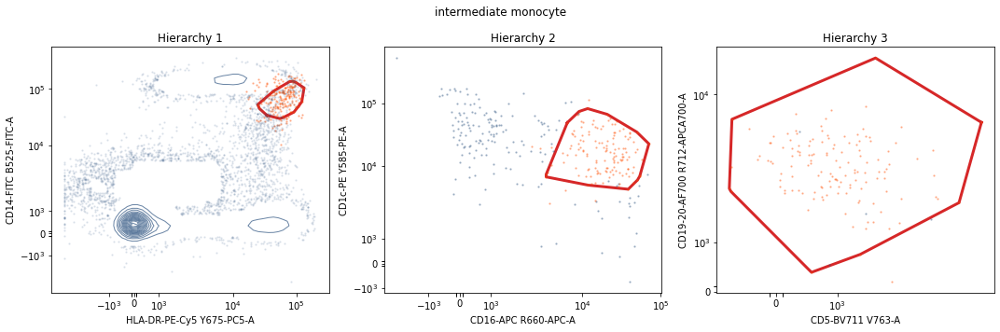

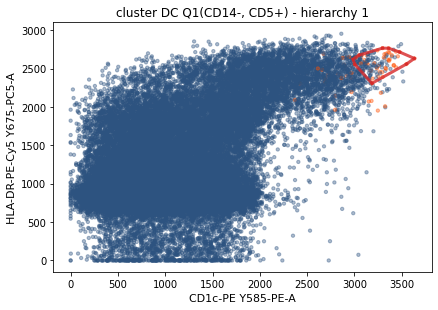

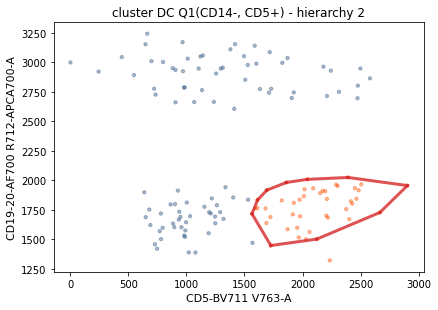

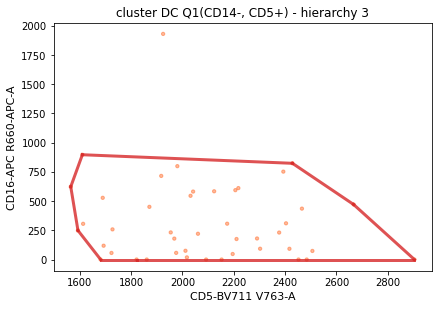

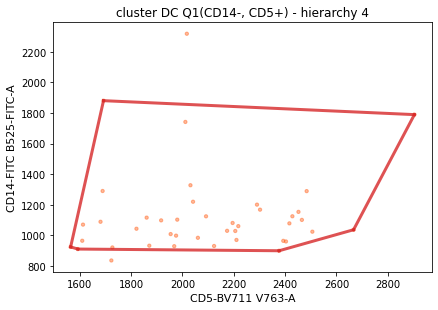

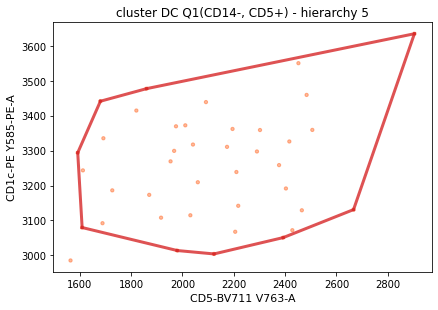

nr_targets :74
nr_non_targets :49926
nr_targets :45
nr_non_targets :92
nr_targets :44
nr_non_targets :0


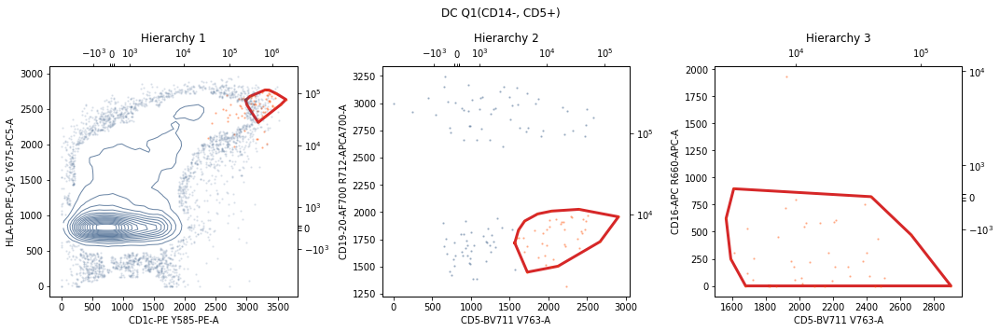

nr_targets :74
nr_non_targets :49926
nr_targets :45
nr_non_targets :92
nr_targets :44
nr_non_targets :0


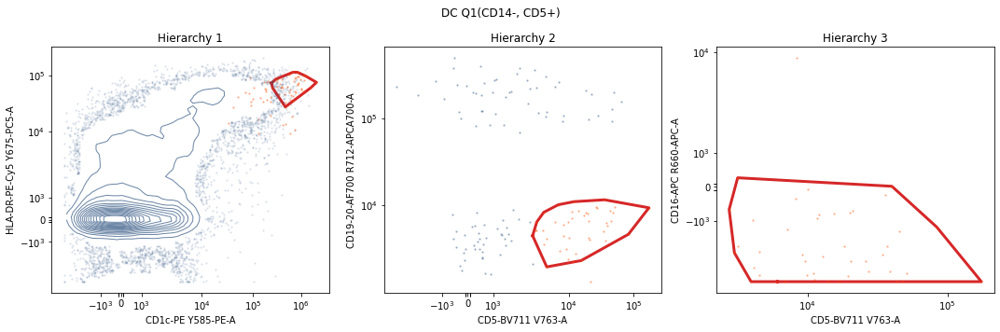

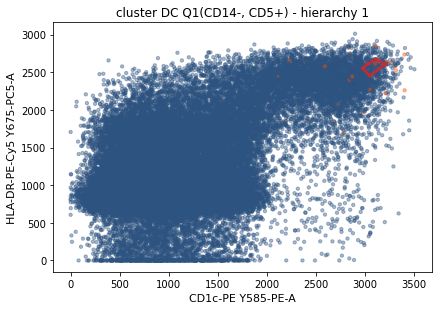

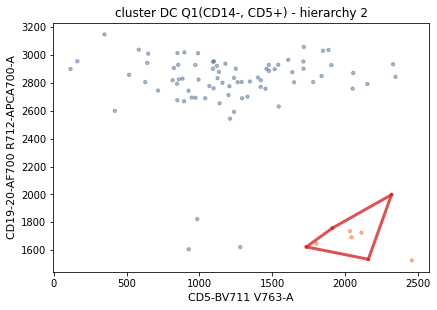

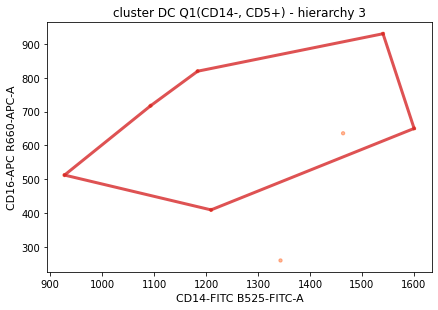

nr_targets :48
nr_non_targets :49952
nr_targets :9
nr_non_targets :78
nr_targets :8
nr_non_targets :0


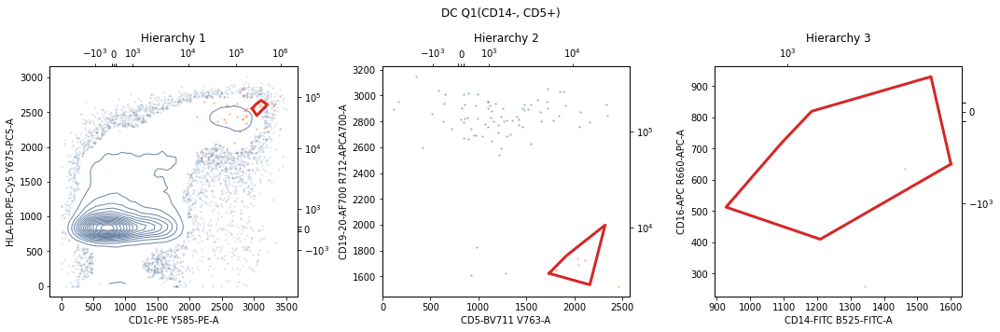

nr_targets :48
nr_non_targets :49952
nr_targets :9
nr_non_targets :78
nr_targets :8
nr_non_targets :0


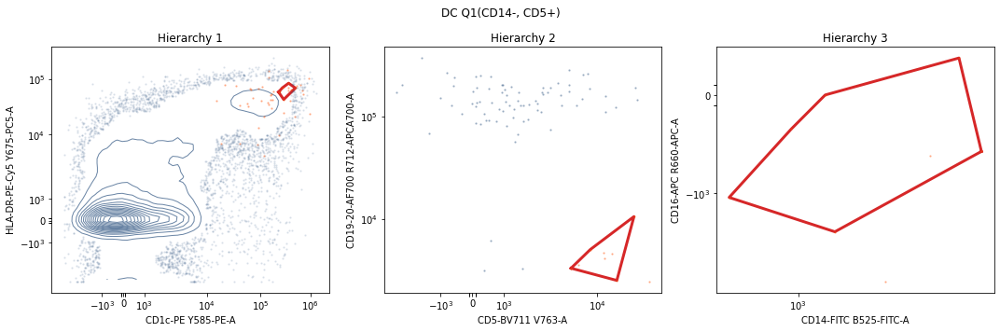

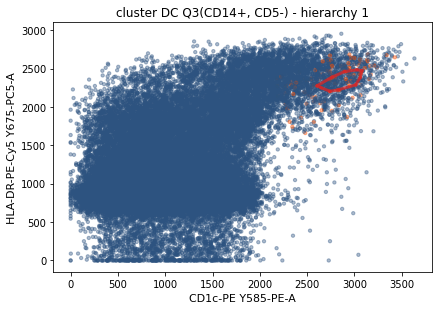

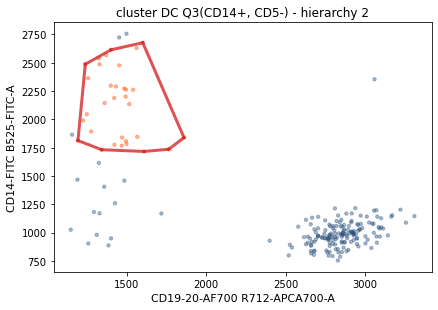

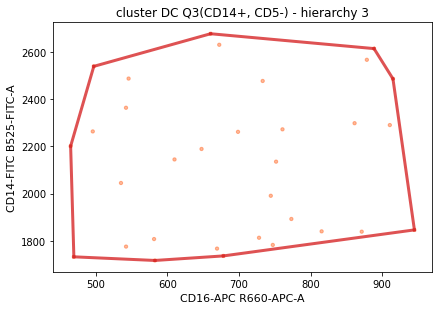

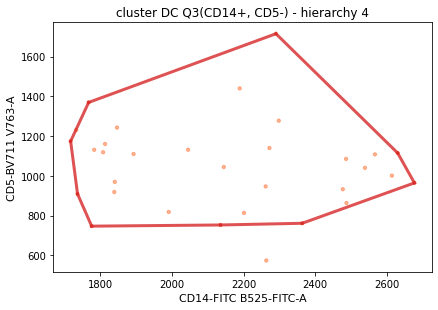

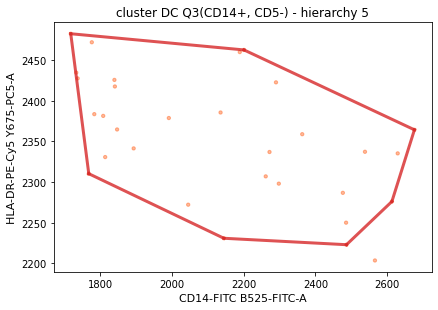

nr_targets :121
nr_non_targets :49879
nr_targets :32
nr_non_targets :176
nr_targets :32
nr_non_targets :0


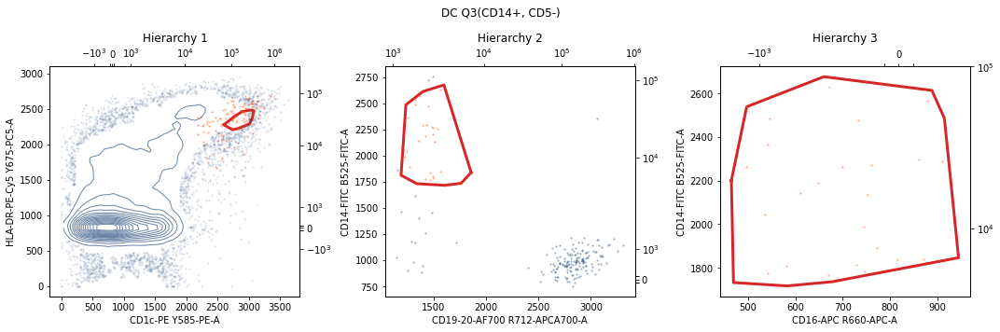

nr_targets :121
nr_non_targets :49879
nr_targets :32
nr_non_targets :176
nr_targets :32
nr_non_targets :0


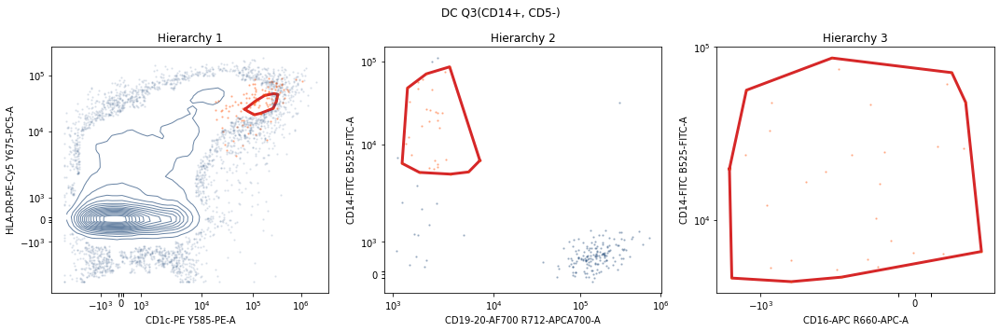

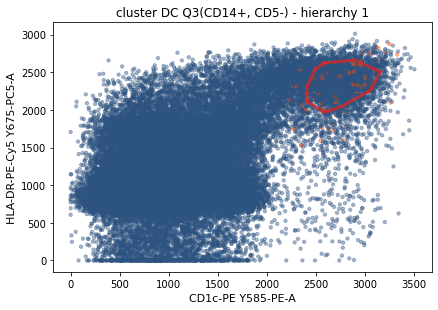

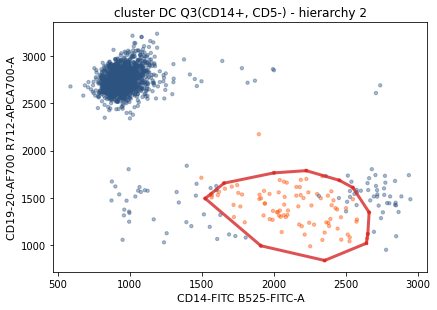

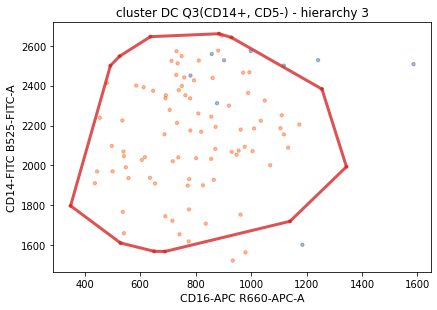

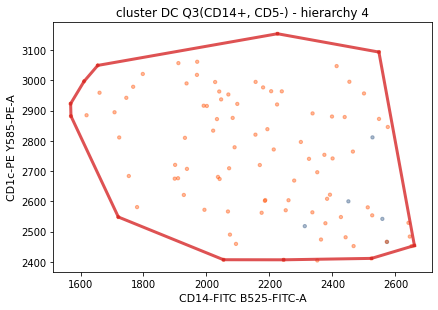

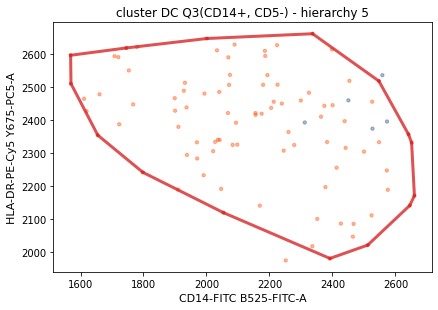

nr_targets :137
nr_non_targets :49863
nr_targets :96
nr_non_targets :1945
nr_targets :94
nr_non_targets :9
nr_targets :92
nr_non_targets :5


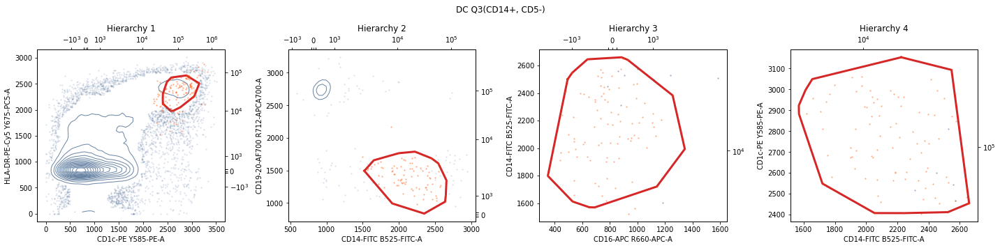

nr_targets :137
nr_non_targets :49863
nr_targets :96
nr_non_targets :1945
nr_targets :94
nr_non_targets :9
nr_targets :92
nr_non_targets :5


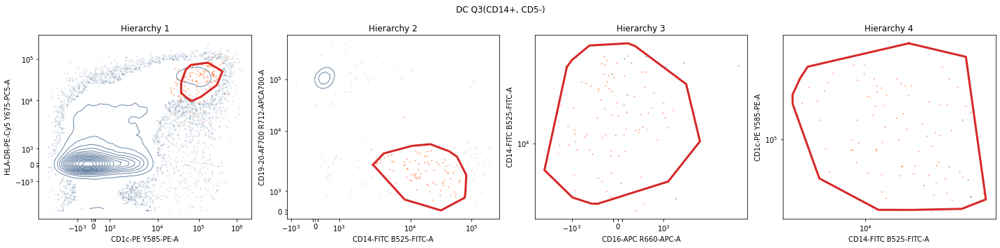

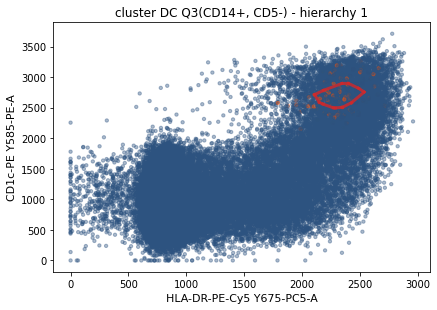

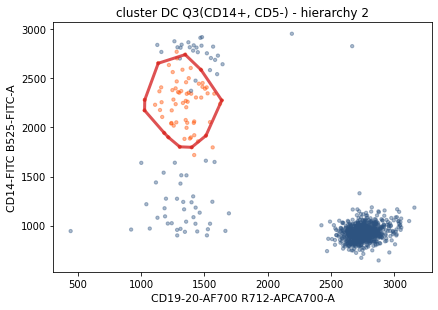

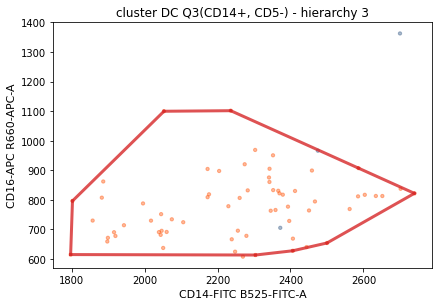

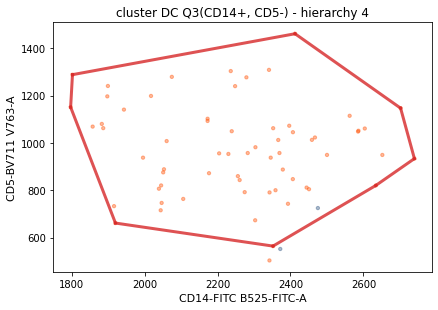

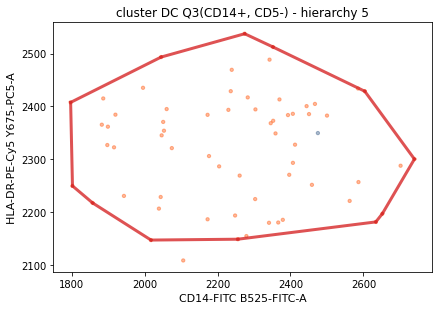

nr_targets :145
nr_non_targets :49855
nr_targets :68
nr_non_targets :864
nr_targets :65
nr_non_targets :3


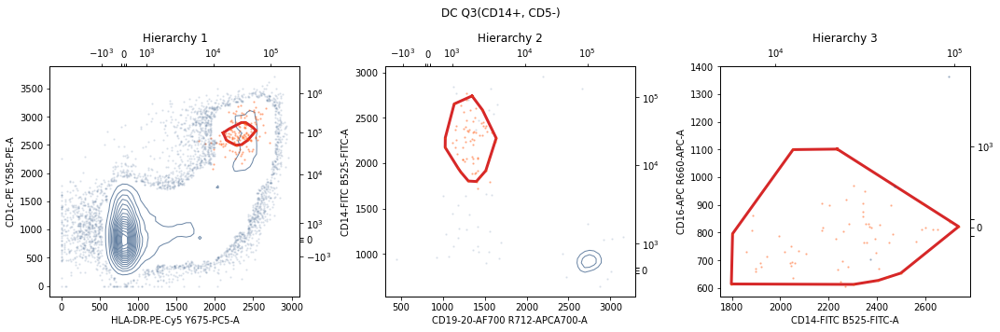

nr_targets :145
nr_non_targets :49855
nr_targets :68
nr_non_targets :864
nr_targets :65
nr_non_targets :3


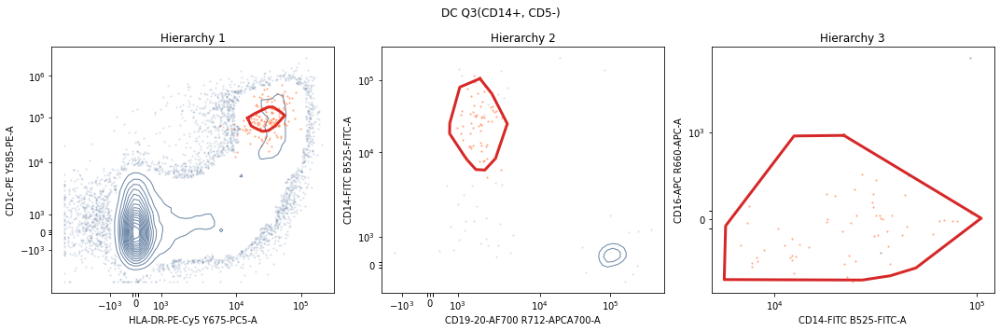

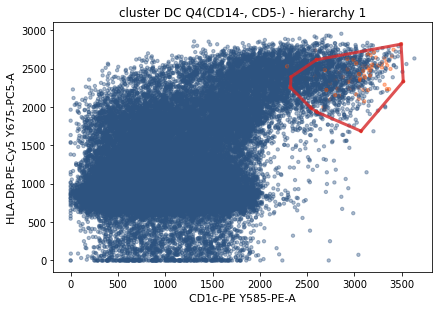

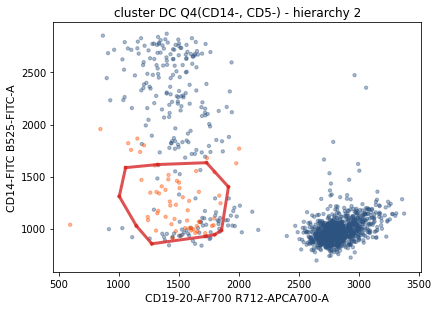

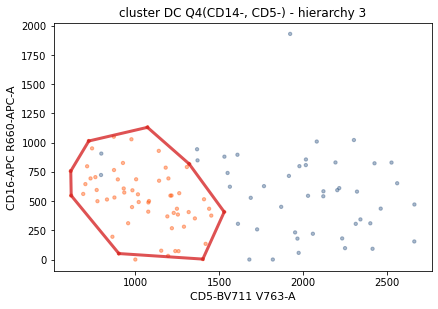

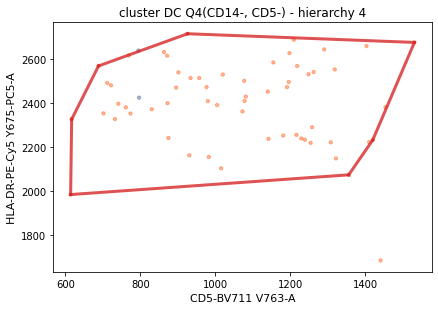

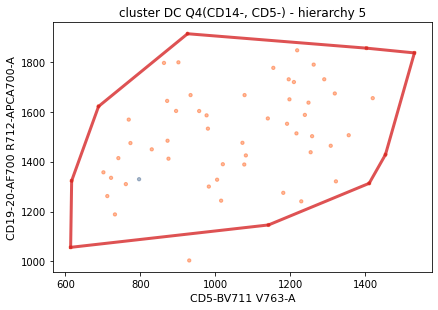

nr_targets :72
nr_non_targets :49928
nr_targets :70
nr_non_targets :1230
nr_targets :60
nr_non_targets :45
nr_targets :59
nr_non_targets :2


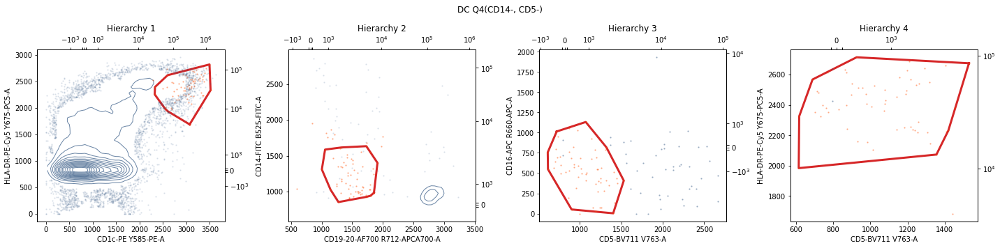

nr_targets :72
nr_non_targets :49928
nr_targets :70
nr_non_targets :1230
nr_targets :60
nr_non_targets :45
nr_targets :59
nr_non_targets :2


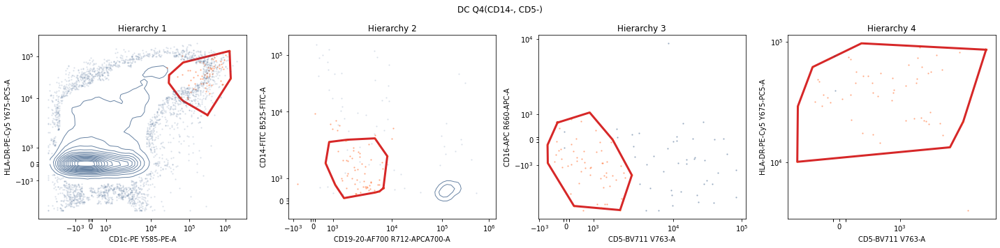

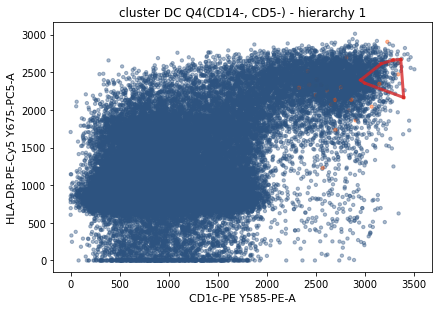

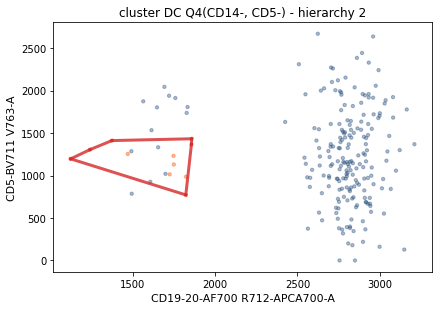

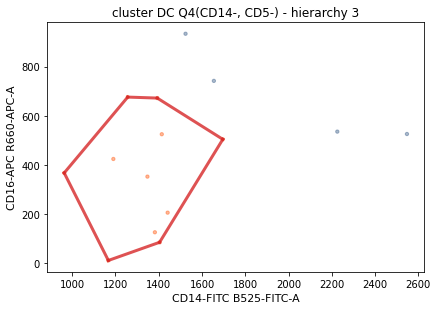

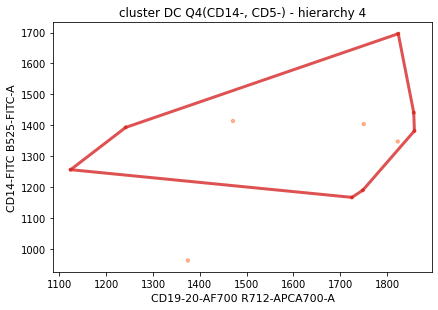

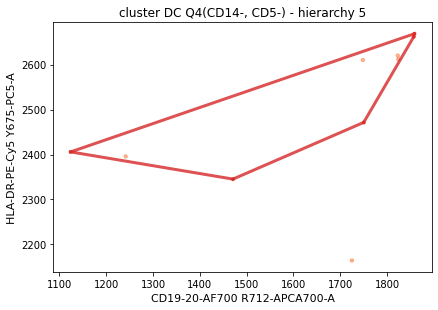

nr_targets :32
nr_non_targets :49968
nr_targets :11
nr_non_targets :205
nr_targets :11
nr_non_targets :4
nr_targets :11
nr_non_targets :0


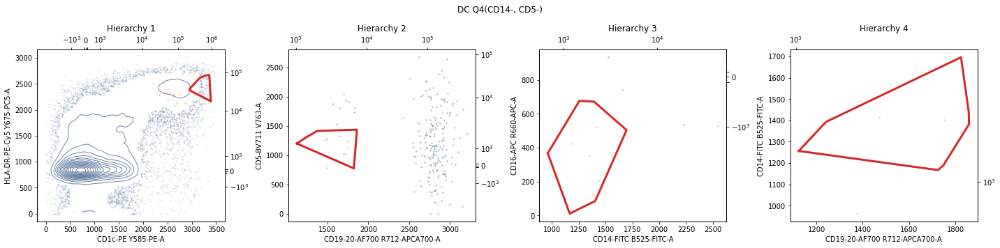

nr_targets :32
nr_non_targets :49968
nr_targets :11
nr_non_targets :205
nr_targets :11
nr_non_targets :4
nr_targets :11
nr_non_targets :0


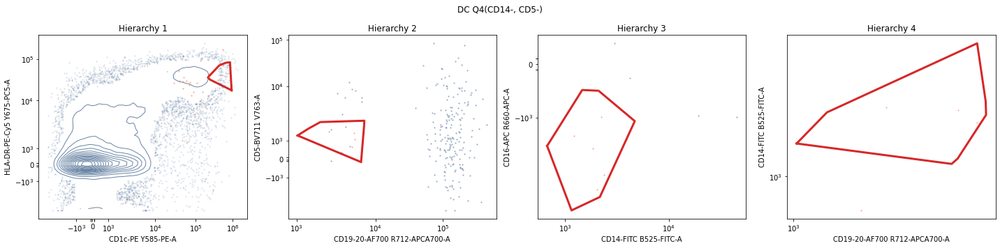

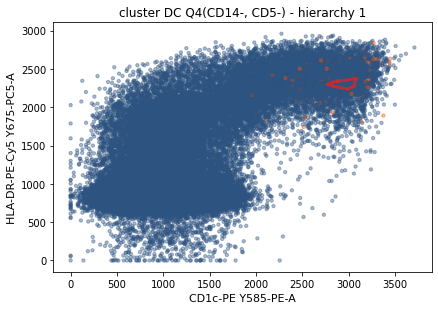

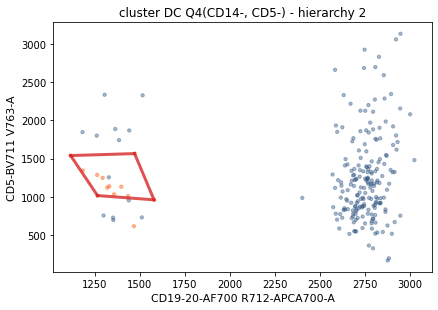

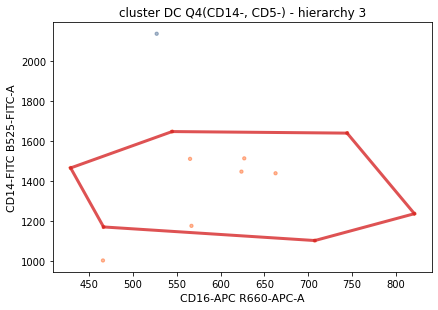

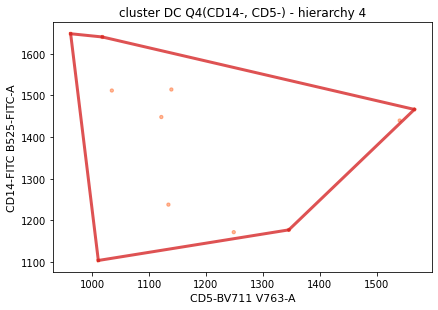

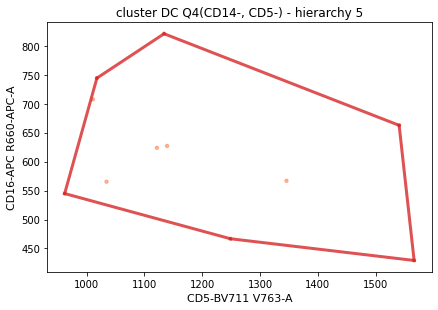

nr_targets :110
nr_non_targets :49890
nr_targets :13
nr_non_targets :207
nr_targets :12
nr_non_targets :1


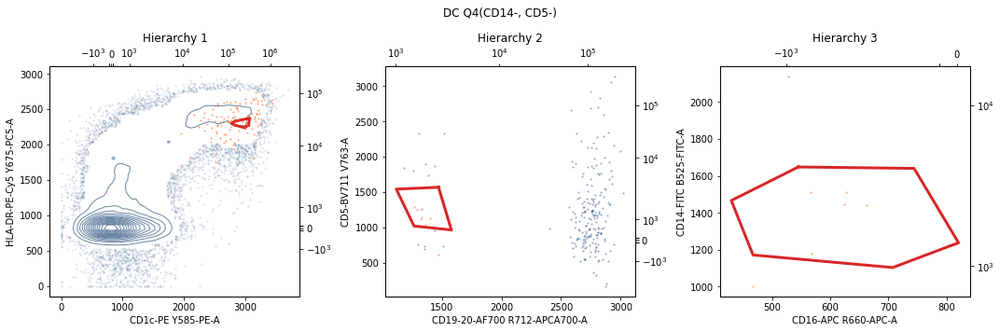

nr_targets :110
nr_non_targets :49890
nr_targets :13
nr_non_targets :207
nr_targets :12
nr_non_targets :1


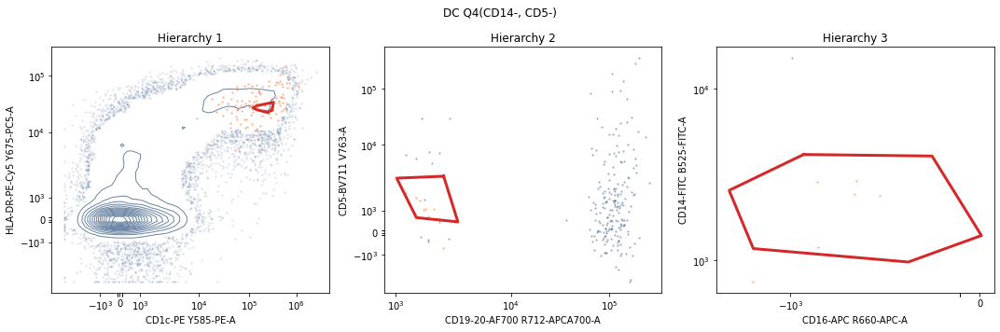

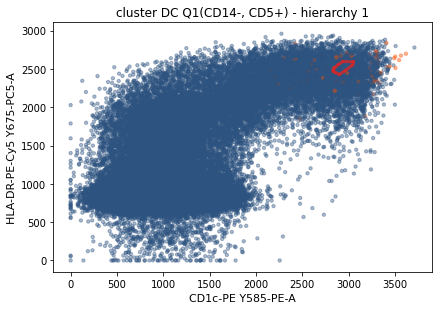

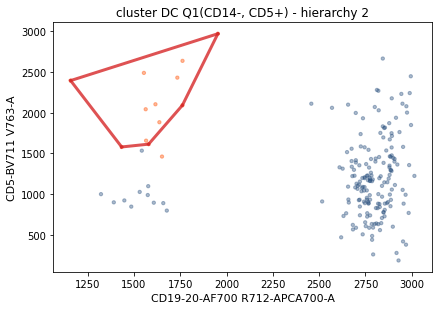

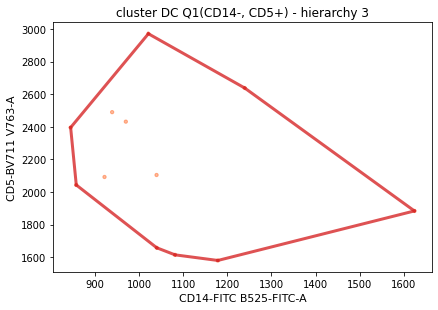

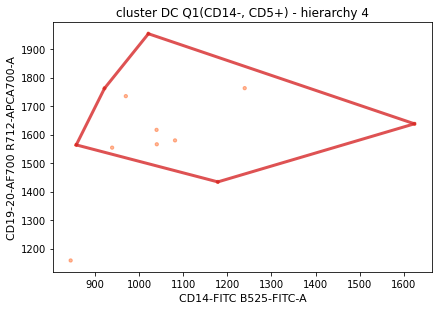

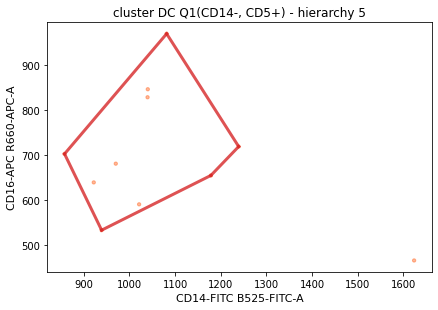

nr_targets :117
nr_non_targets :49883
nr_targets :13
nr_non_targets :182
nr_targets :12
nr_non_targets :0


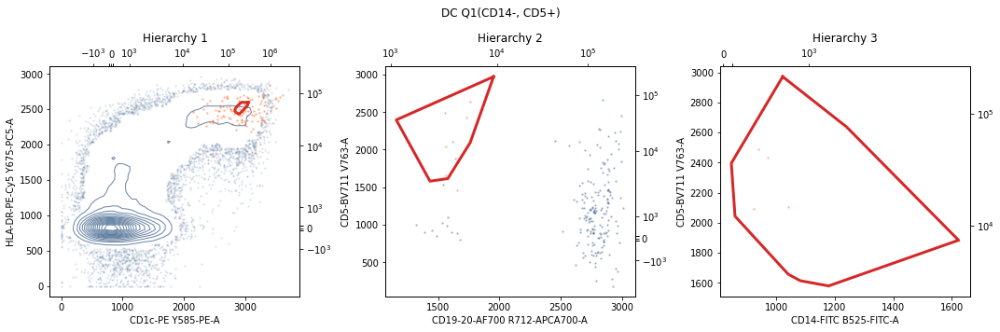

nr_targets :117
nr_non_targets :49883
nr_targets :13
nr_non_targets :182
nr_targets :12
nr_non_targets :0


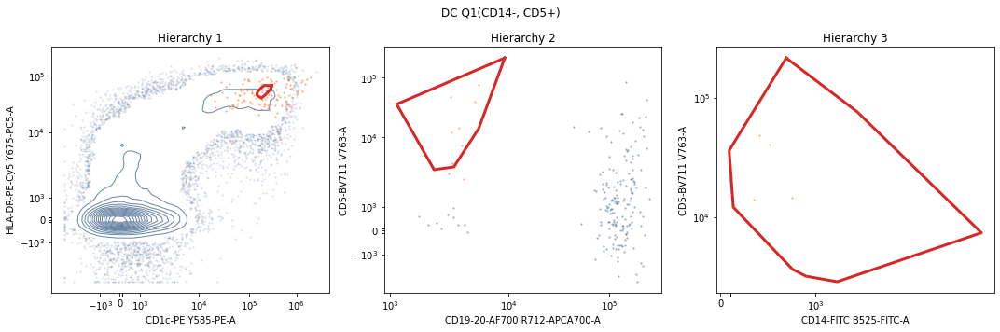

In [58]:
for cluster_key in dirIDs:
    if not cluster_key.startswith('cluster'):
        continue
    if cluster_key.startswith('cluster_myeloid'):
        continue
    meta_info_path = os.path.join(add_hull_path, cluster_key, 'meta_info.npy')
    meta_info = np.load(meta_info_path,allow_pickle=True).item()

    population,population_path,base_df = prepare_contour_plot(meta_info = meta_info,
                                                          add_hull_path = add_hull_path,
                                                          run_ID =0)
    #read performance summary to obtain number of clusters
    per_summary = pd.read_csv(os.path.join(add_hull_path, cluster_key, 'performance_summary.csv'))
    num_hierarchies = np.min([per_summary['hierarchy'].max() + 1, 5])
    run_ID =0
    for mode in ['both', 'replace']:
        path = os.path.join(population_path, f'{cluster_key}')
        save = os.path.join(population_path, f'{cluster_key}',
                    population + f'_gating_strategy_{mode}.pdf')
        save_png = os.path.join(population_path, f'{cluster_key}', population + f'_gating_strategy_{mode}.png')
        if not os.path.exists(path):
            os.makedirs(path)
        contour_lines_separate_outliers(meta_info, run_ID, base_df, population,population_path,
                    num_hierarchies=num_hierarchies, pop_min=500,
                                        mode=mode, transform_func=lut_func, inverse_transform_func=inverse_lut_func,
                        save = save,save_png=save_png)

Plot colorbar with two different scales. Please note that this mapping depends on the individual parameters of the transformation. In this use case, we use the same parameters for transformation of every feature, such that the colorbar is universal for this dataset. However, the mapping changes if one uses different parameters depending on the fluorophors. 

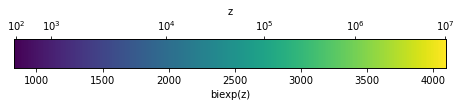

In [362]:
import matplotlib as mpl

orientation = 'horizontal'
lims = np.array([830, 4100])
power_lims = np.round(np.log10(inverse_lut_func(lims)))
if np.any(np.isnan(power_lims)):
    print("Limit is negative. Use 2 instead.")
    power_lims[np.isnan(power_lims)] = 2

# Check if the lut_func of the power limits is within the range of the limits
tick_lims = lut_func(10**power_lims)
if tick_lims[0]<lims[0]:
    power_lims[0] = power_lims[0] + 1
if tick_lims[1]>lims[1]:
    power_lims[1] = power_lims[1] - 1
# Check if the power difference is still at least 1
if power_lims[1] - power_lims[0] <= 0:
    print("Cannot display original scale as powers of 10.\n Increase plot limits.")

fig = plt.figure()
if orientation == 'horizontal':
    ax = fig.add_axes([0., 1, 1, 0.1])
elif orientation =='vertical':    
    ax = fig.add_axes([0., 4, 0.1, 1])

cbar = mpl.colorbar.ColorbarBase(ax, orientation=orientation, 
                               cmap='viridis', norm=mpl.colors.Normalize(lims[0], lims[1]))

# arange ticks for biexp scale
divid = 500
tick_minmax = np.round(np.array(lims)/divid)
diff_tick = tick_minmax[1] - tick_minmax[0]
if diff_tick < 1:
    divid = 100* np.floor((lims[1] - lims[0])/700) #aim to get 7 ticks on the colorbar
    tick_minmax = np.round(np.array(lims)/divid)

ticks=np.arange(tick_minmax[0] * divid, tick_minmax[1] * divid +1, divid)
iticks=lut_func(10**np.arange(power_lims[0],power_lims[1]+1,1))
iticklabels = [ f"$10^{int(z)}$" for z in np.arange(power_lims[0],power_lims[1]+1,1) ]
cbar.set_ticks(ticks)
cbar.set_label("biexp(z)")

#cbar = plt.colorbar(im, cax=cax)
if orientation == 'horizontal':
    cax2 = ax.twiny()
    cbar.ax.xaxis.set_label_position("bottom")
    cax2.set_xlim(lims[0],lims[1])
    cax2.set_xticks(iticks)
    cax2.set_xticklabels(iticklabels)
    cax2.set_xlabel("z")
elif orientation =='vertical':
    cax2 = ax.twinx()
    cbar.ax.yaxis.set_label_position("left")
    cax2.set_ylim(lims[0],lims[1])
    cax2.set_yticks(iticks)
    cax2.set_yticklabels(iticklabels)
    cax2.set_ylabel("z")

plt.show()

End of the notebook.